# Data Exploration

In [1]:
import pandas as pd
import numpy as np
import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.linear_model import LinearRegression

## CO2 Total by Country 1970-2021


### Raw Data / Pathway

In [2]:
CO2_yearly_path = "../raw_data/CO2_YEARLY_DATA_1970-2021.xlsx"

As the data is very clean already this looks like a good framework to use for the other datasets which are very similar to this one.

In [30]:
# Removed the first rows that have no relevance and reset the index.
co2_year = pd.read_excel(CO2_yearly_path, sheet_name="TOTALS BY COUNTRY", skiprows=[0, 1, 2, 3, 4, 5, 6, 7, 8], header=1) 
co2_year.head()


,IPCC_annex,C_group_IM24_sh,Country_code_A3,Name,Substance,Y_1970,Y_1971,Y_1972,Y_1973,Y_1974,...,Y_2012,Y_2013,Y_2014,Y_2015,Y_2016,Y_2017,Y_2018,Y_2019,Y_2020,Y_2021
0,Non-Annex_I,Rest Central America,ABW,Aruba,CO2,95.065424,94.503709,105.847814,109.863856,99.977179,...,1637.822831,1605.689731,1633.584420,1626.234050,1597.398255,1335.792882,1366.614574,1404.705123,1166.018409,1295.818804
1,Non-Annex_I,India +,AFG,Afghanistan,CO2,3343.054709,3318.411036,3545.865063,3592.563616,4075.638761,...,14462.288815,12796.268484,12478.108782,12551.087669,11760.799383,12117.693742,12736.811832,12215.717086,12525.011330,12553.576369
2,Non-Annex_I,Southern_Africa,AGO,Angola,CO2,20393.274068,19959.926969,21860.851718,22960.875811,23436.330631,...,45747.276981,51282.174272,53677.191990,56211.792887,55507.493078,51285.300069,49702.305850,51343.735537,49153.126915,50275.123467
3,Non-Annex_I,Rest Central America,AIA,Anguilla,CO2,2.168292,2.168325,2.263753,2.108963,2.350261,...,26.023228,27.940512,27.896061,28.005426,28.339881,29.062445,28.222994,27.579993,22.779488,25.408720
4,Int. Aviation,Int. Aviation,AIR,Int. Aviation,CO2,169300.996554,169300.996554,179147.487130,186892.096441,179793.330898,...,472721.118697,480909.126246,496627.696509,524654.034526,548207.777357,582230.489693,609630.481638,617763.229264,338144.083387,390166.250062


In [31]:
# Drop irrelevant columns
co2_year_df = co2_year.drop(['IPCC_annex', 'IPCC_annex', 'Name', 'C_group_IM24_sh', 'Substance'], axis=1)

# Transform dataframe for easier use in graphs and time-series and rename the columns so as to be better recognisable.
co2_year_df= co2_year_df.melt(id_vars=['Country_code_A3']).rename(columns={'Country_code_A3':'country', 'variable':'year', 'value':'CO2'})

# Remove prefix for year
co2_year_df['year'] = co2_year_df['year'].str.removeprefix("Y_")

# Reset the year column as data type integer.
co2_year_df = co2_year_df.astype({"year":"int"}) 

co2_year_df

,country,year,CO2
0,ABW,1970,95.065424
1,AFG,1970,3343.054709
2,AGO,1970,20393.274068
3,AIA,1970,2.168292
4,AIR,1970,169300.996554
...,...,...,...
10915,WSM,2021,430.909959
10916,YEM,2021,12592.042487
10917,ZAF,2021,486199.588051
10918,ZMB,2021,36992.720366


In [32]:
co2_year_df.dtypes

country     object
year         int64
CO2        float64
dtype: object

In [33]:
# Format df so as to better demonstrate the changes in previous cell.
co2_year_df = co2_year_df.groupby(["country", "year"]).sum().reset_index()
co2_year_df


,country,year,CO2
0,ABW,1970,95.065424
1,ABW,1971,94.503709
2,ABW,1972,105.847814
3,ABW,1973,109.863856
4,ABW,1974,99.977179
...,...,...,...
10915,ZWE,2017,43603.179524
10916,ZWE,2018,46425.903295
10917,ZWE,2019,45146.571907
10918,ZWE,2020,45857.980830


In [34]:
# Plot the newly cleaned/filtered dataset
fig = px.line(co2_year_df, x="year", y="CO2", color='country', width=1200, height=800)
fig.show()

## Meryem - Data Analysis

## EDA

(0.0, 900.0)

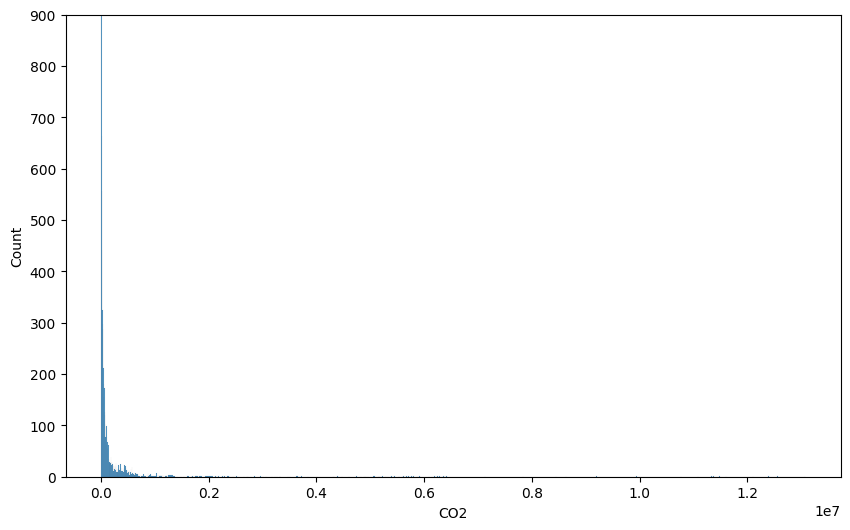

In [35]:
plt.figure(figsize=(10,6))
sns.histplot(x=co2_year_df['CO2'] )
plt.ylim(top=900)

<Axes: xlabel='CO2'>

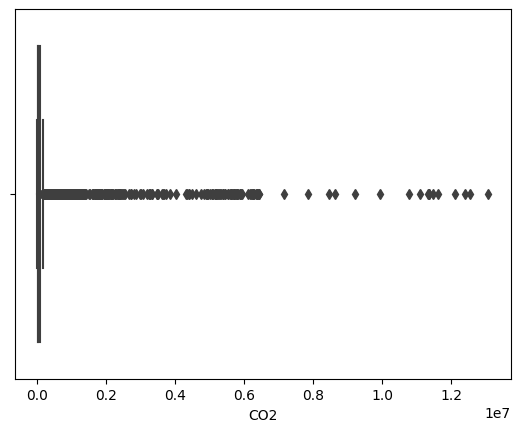

In [36]:
sns.boxplot(x=co2_year_df['CO2'])

In [37]:
Total_mean=co2_year_df.groupby(['country'])['CO2'].mean().sort_values(ascending=False)[0:100].reset_index()
top_10_countries_mean=co2_year_df.groupby(['country'])['CO2'].mean().sort_values(ascending=False)[0:10].reset_index()
year_mean_10_total=co2_year_df.groupby(['year'])['CO2'].mean().sort_values(ascending=False)[0:10].reset_index()

In [38]:
fig1= px.pie(top_10_countries_mean,values='CO2',names='country',title= "Top 10 Countries by Total Emission")
fig1.show()

In [39]:
fig2= px.pie(year_mean_10_total,values='CO2',names='year',title= "Top 10 Years of Highest Total Emission")
fig2.show()

In [40]:
def chlorepath(data,color):
    fig=px.choropleth(data, locations="country",
                    color= color, 
                    hover_name="country",
                    color_continuous_scale=px.colors.sequential.Plasma)
    fig.show()

In [41]:
fig3=chlorepath(Total_mean,'CO2')

## Base Model - Simple Moving Average 

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

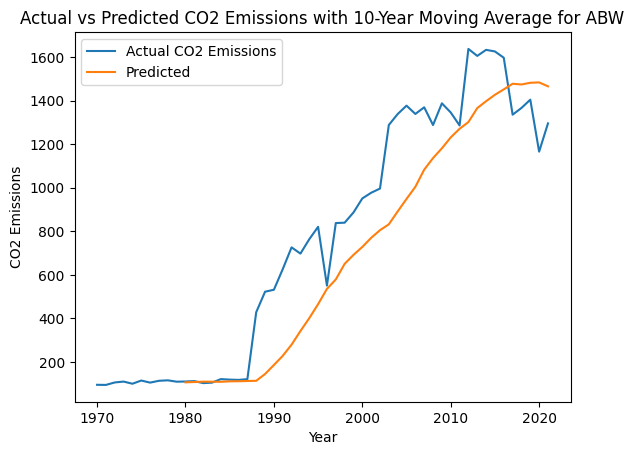

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

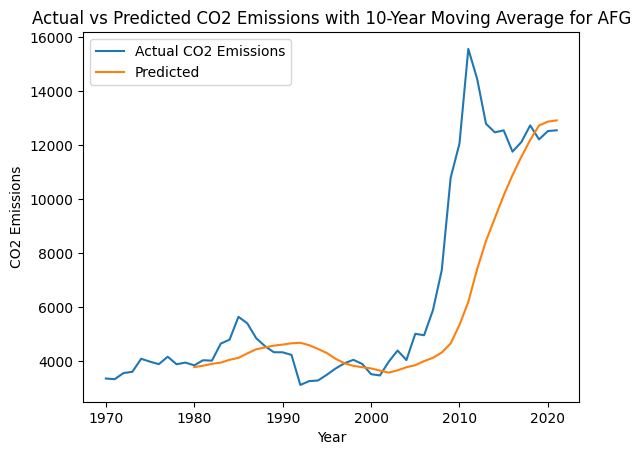

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

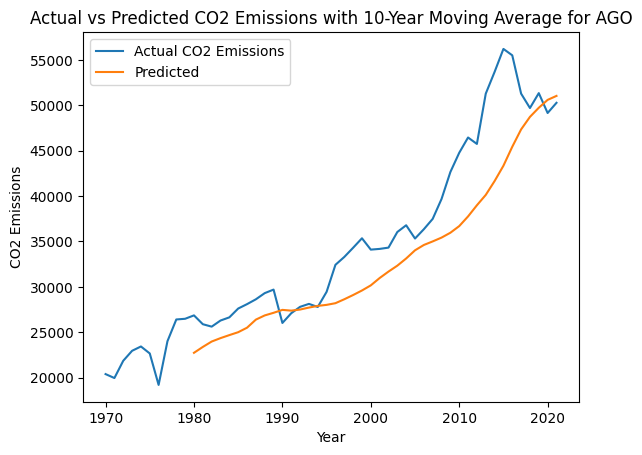

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

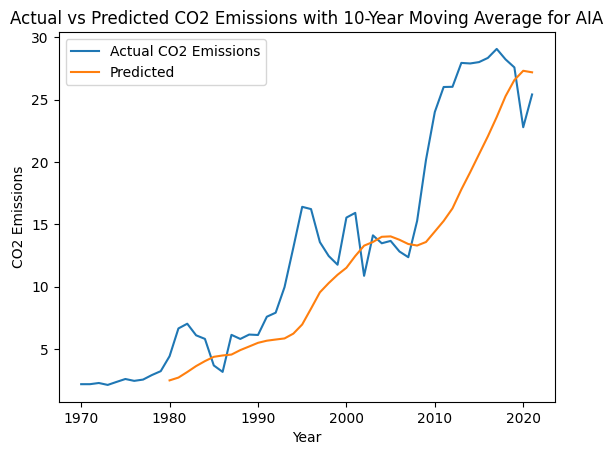

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

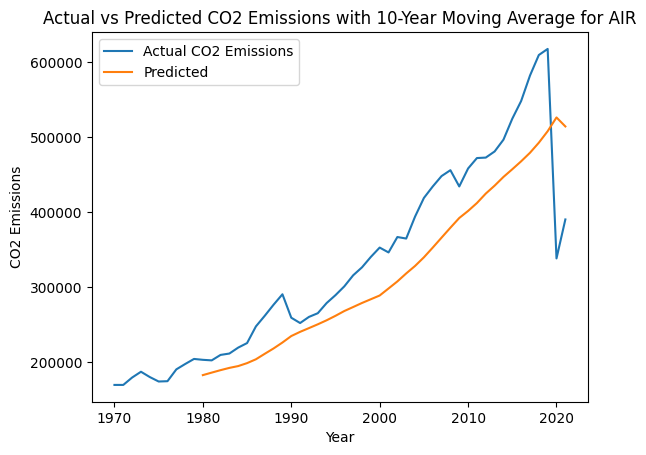

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

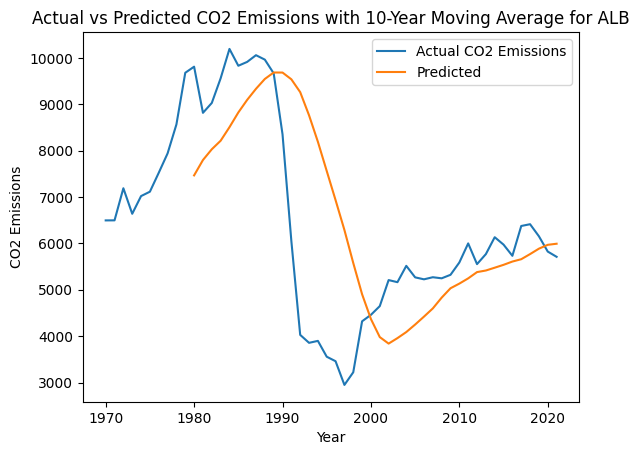

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

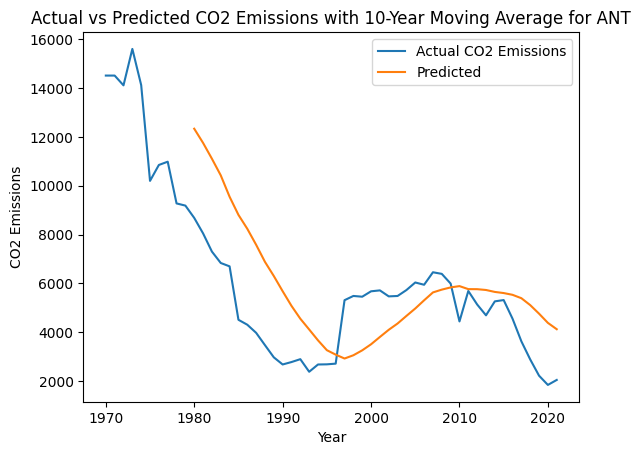

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

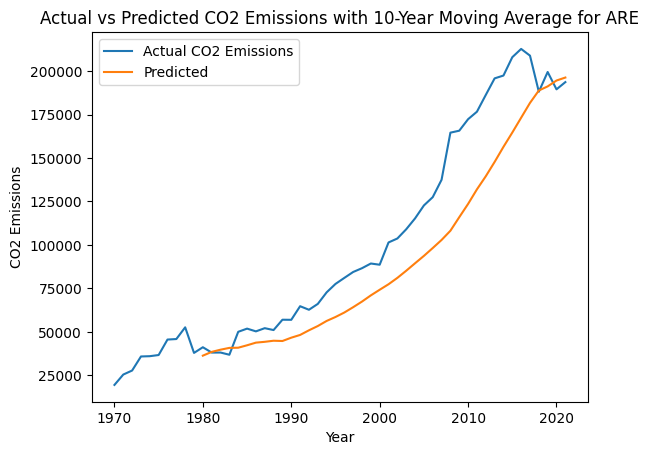

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

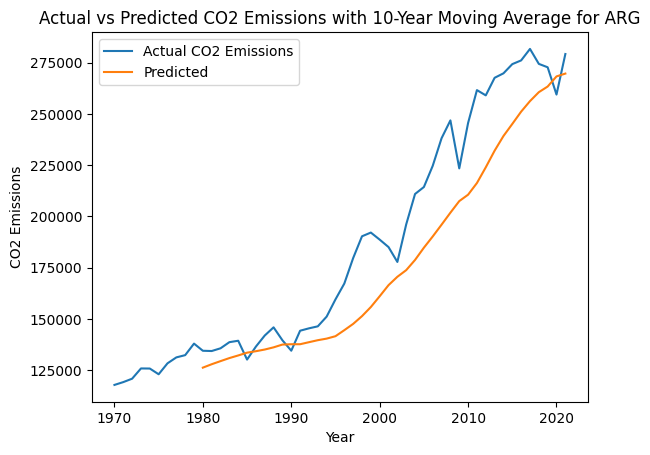

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

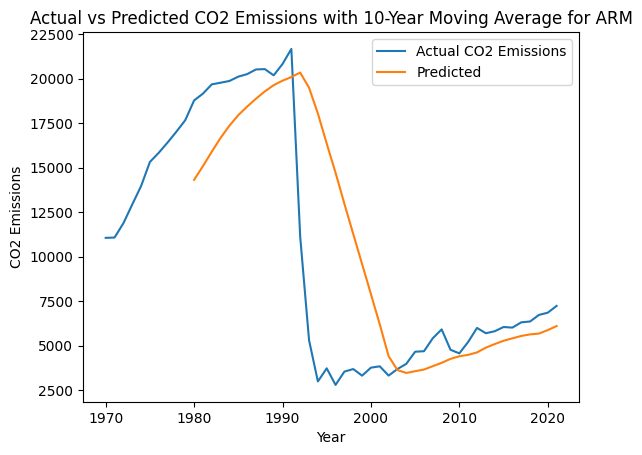

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

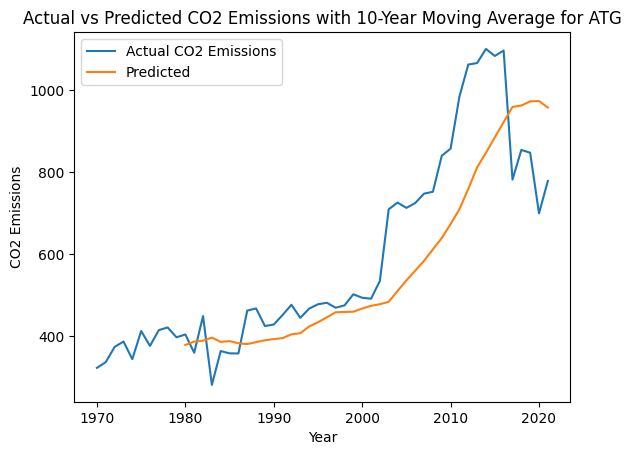

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

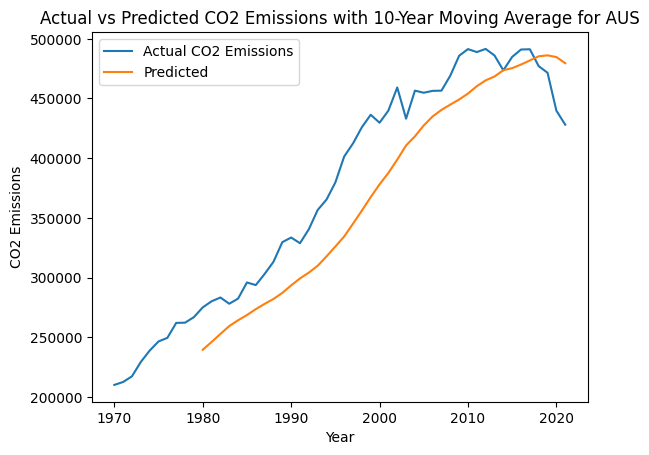

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

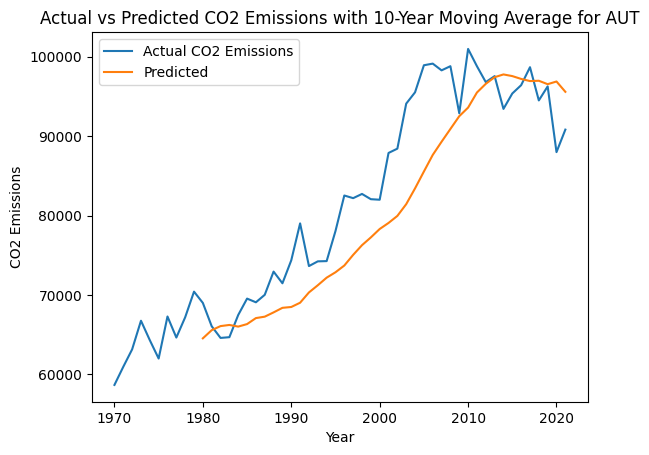

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

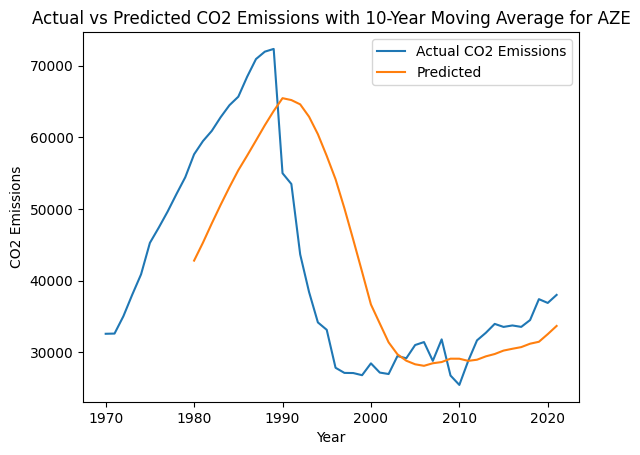

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

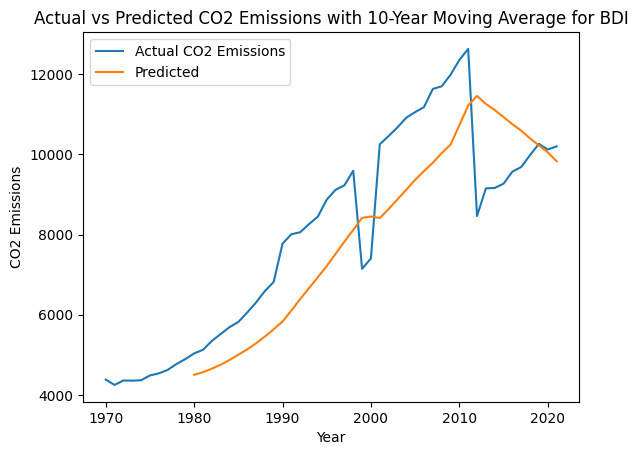

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

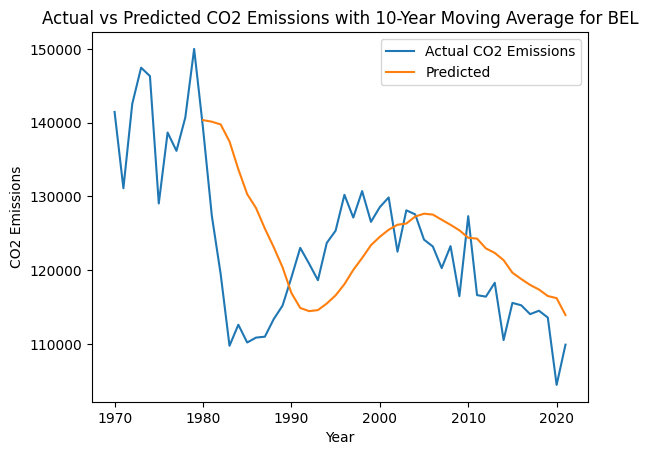

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

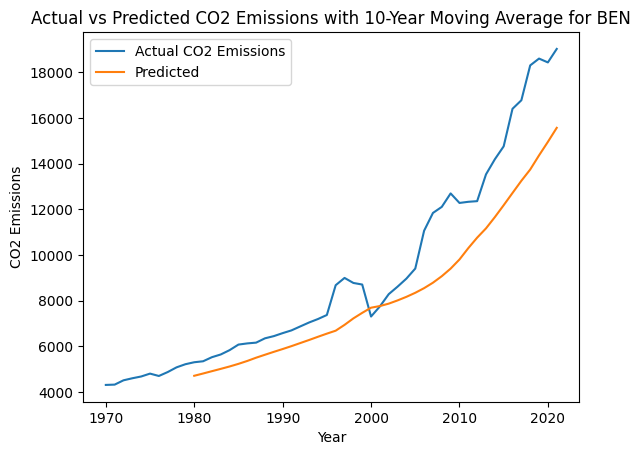

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

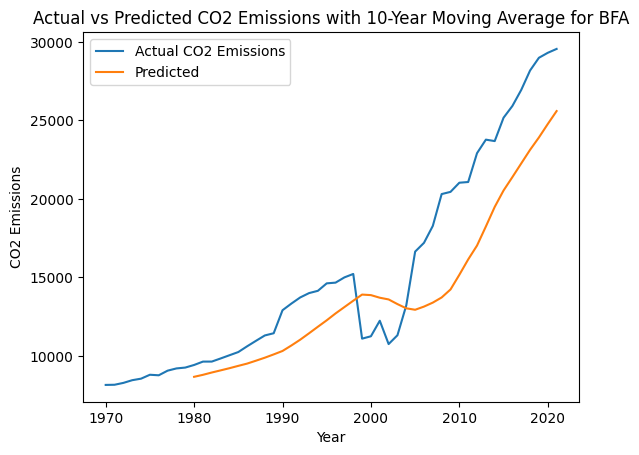

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

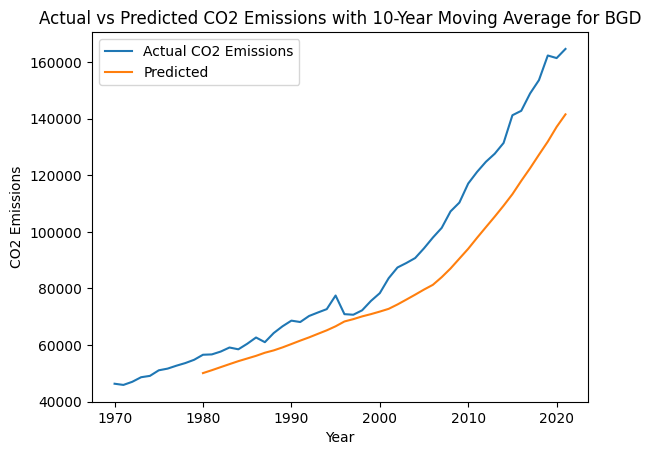

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

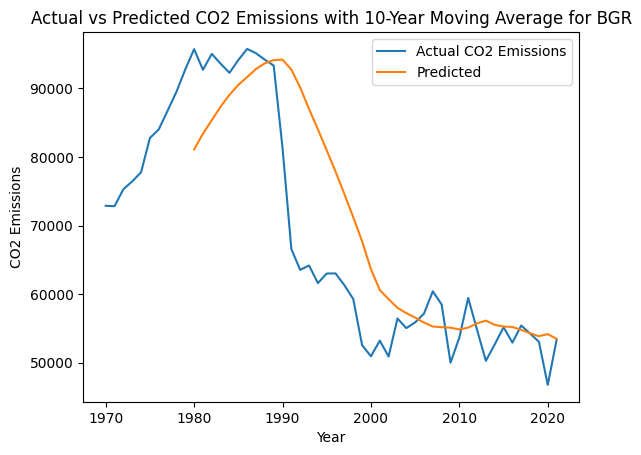

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

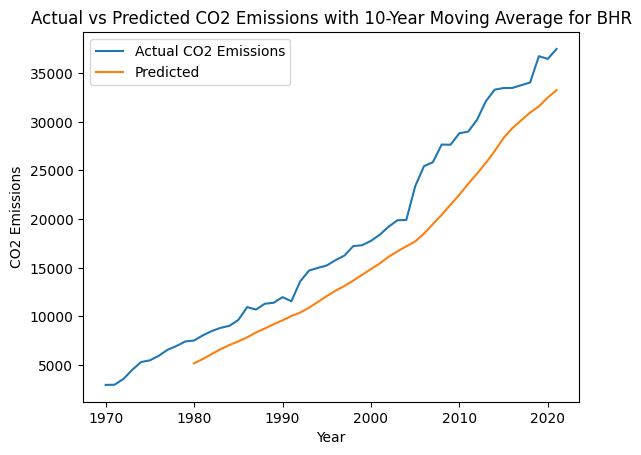

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

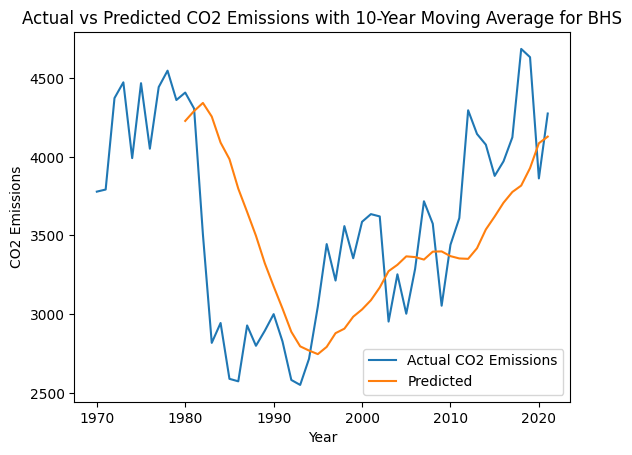

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

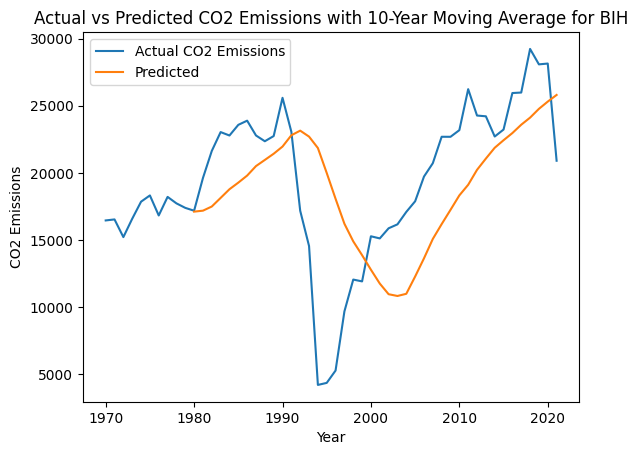

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

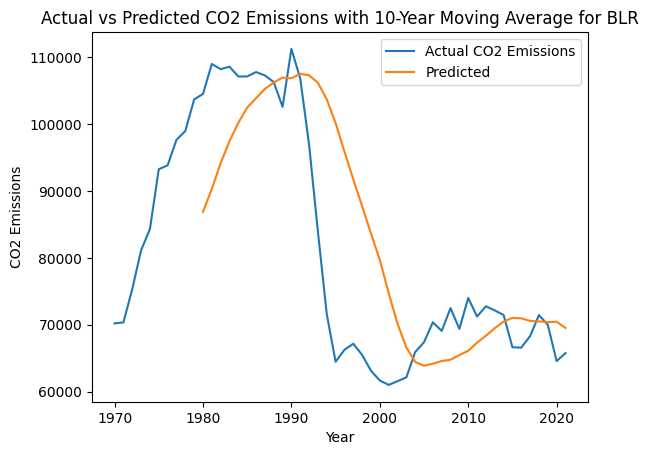

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

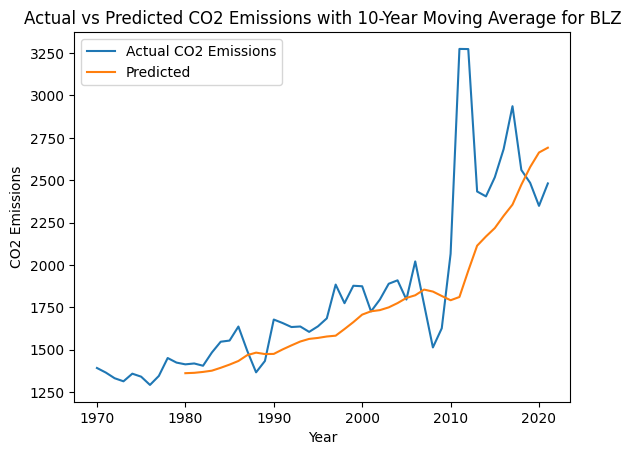

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

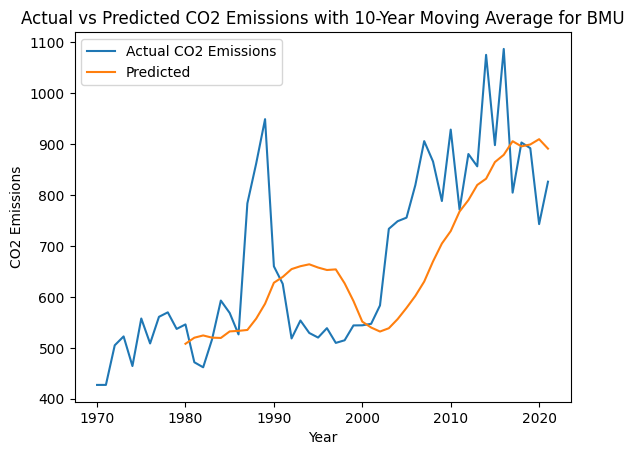

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

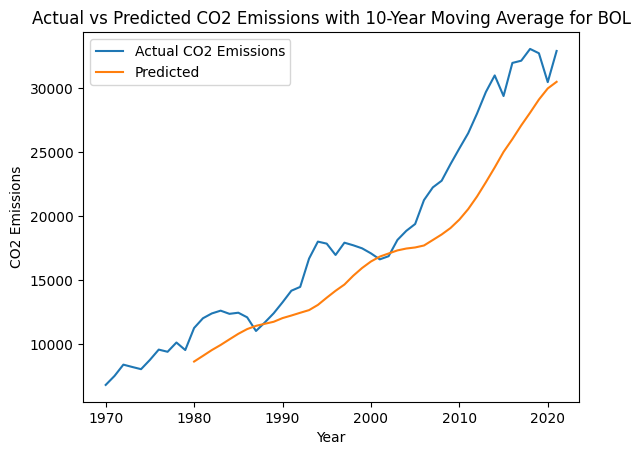

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

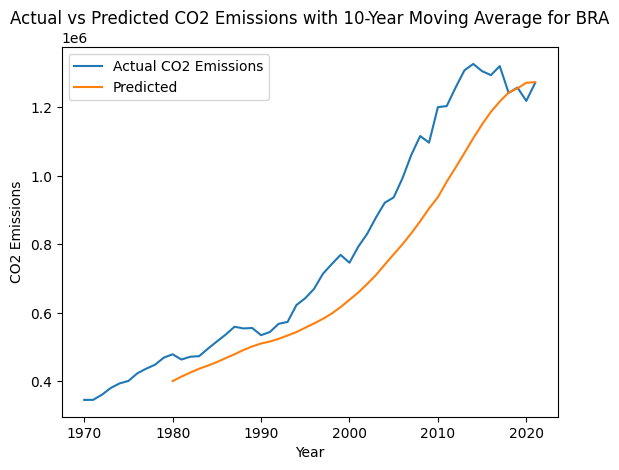

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

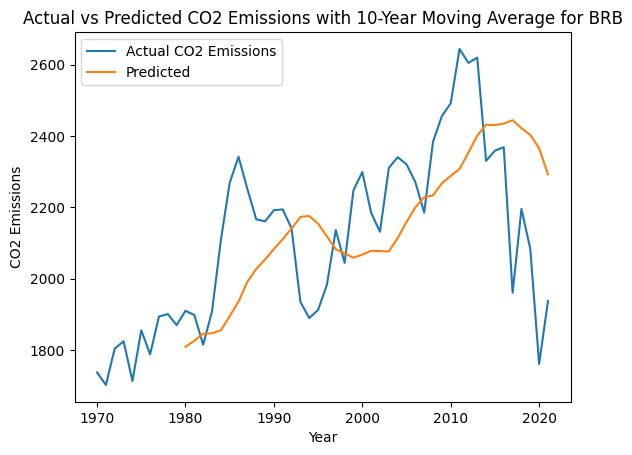

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

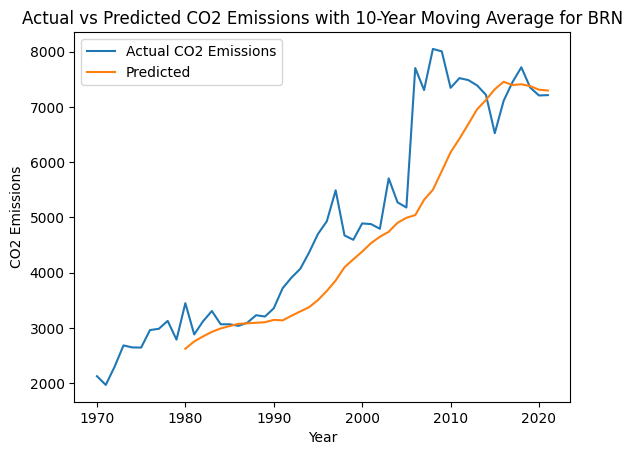

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

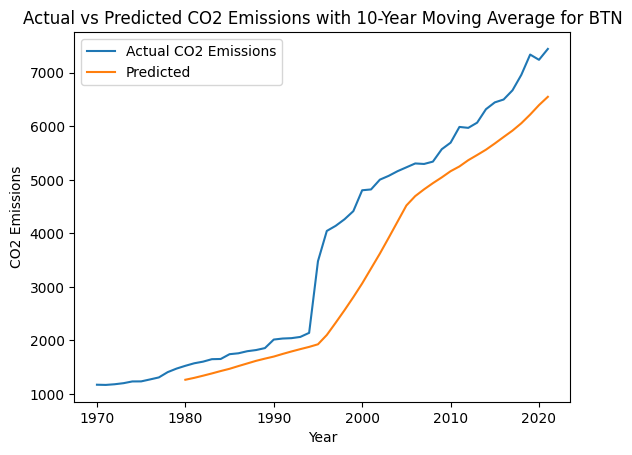

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

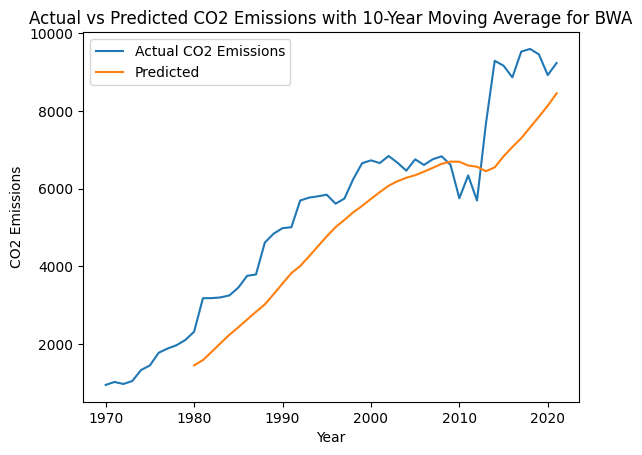

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

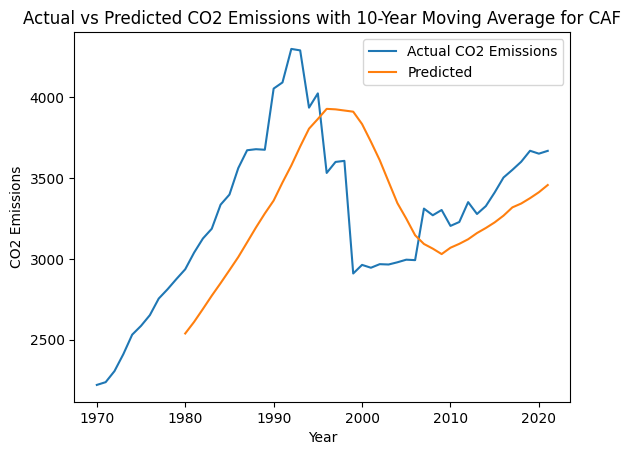

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

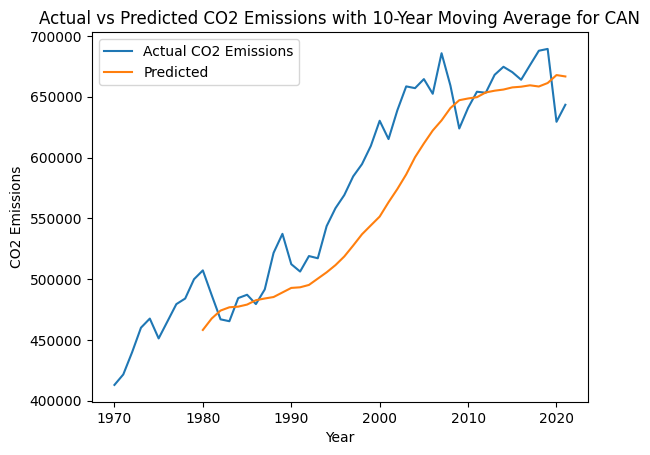

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

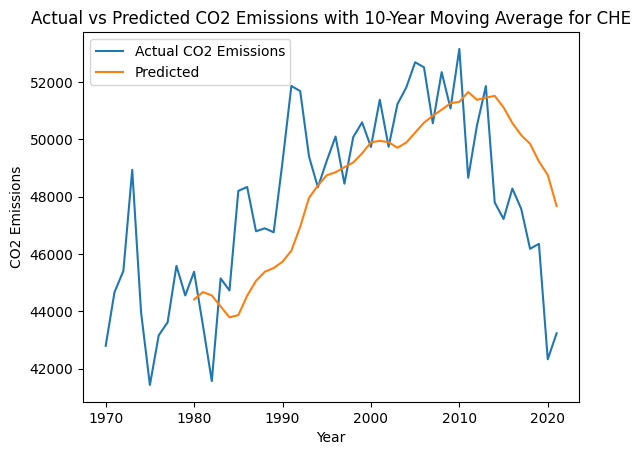

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

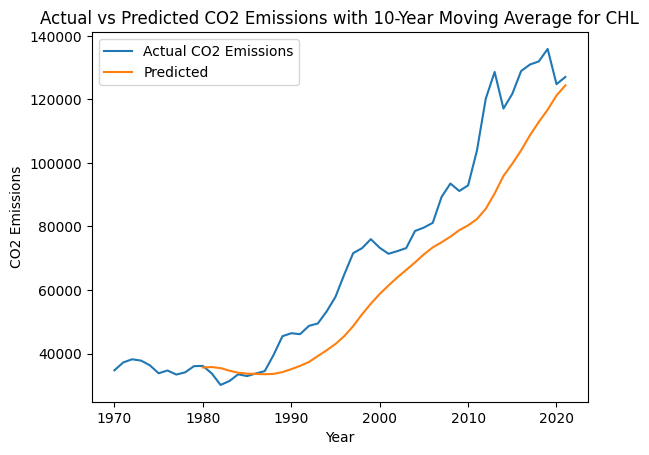

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

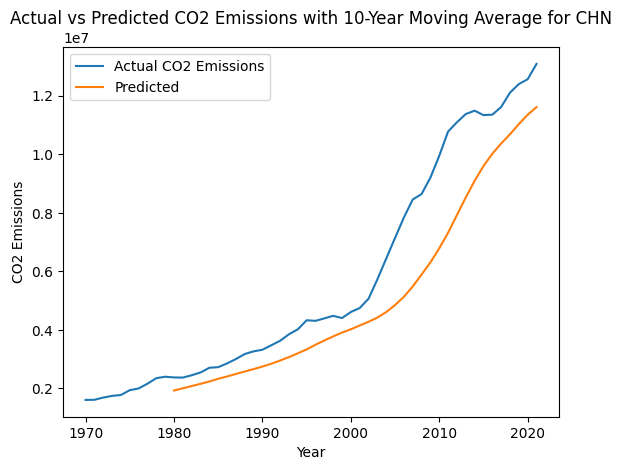

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

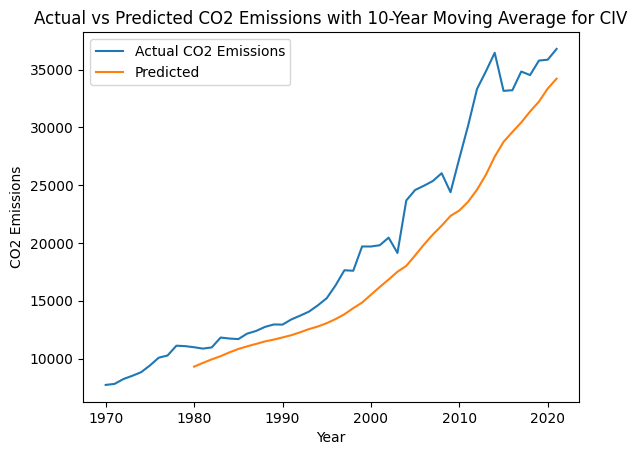

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

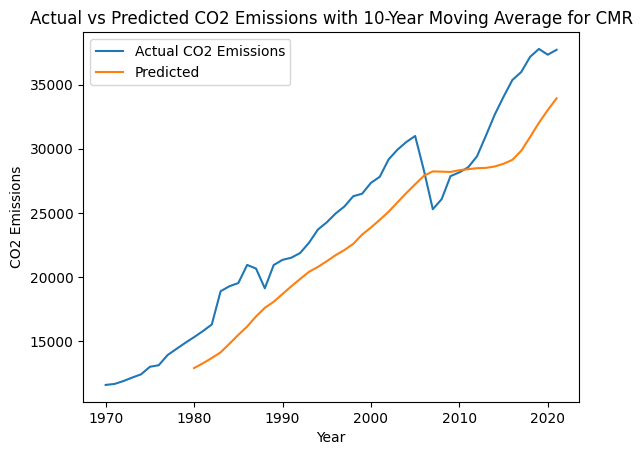

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

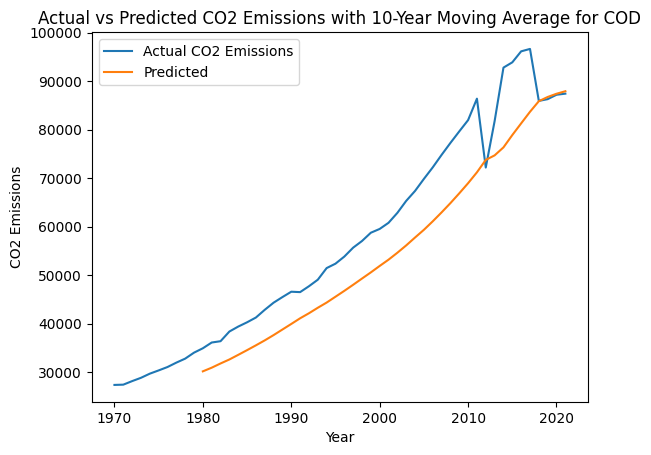

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

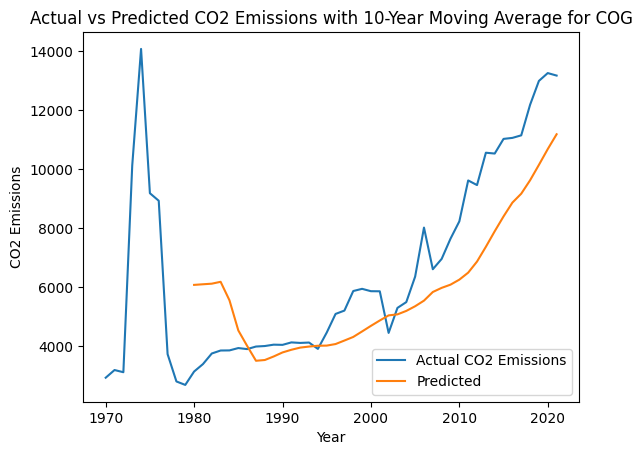

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

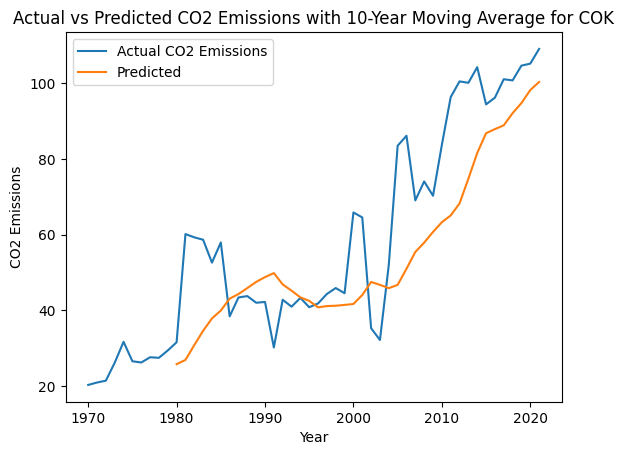

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

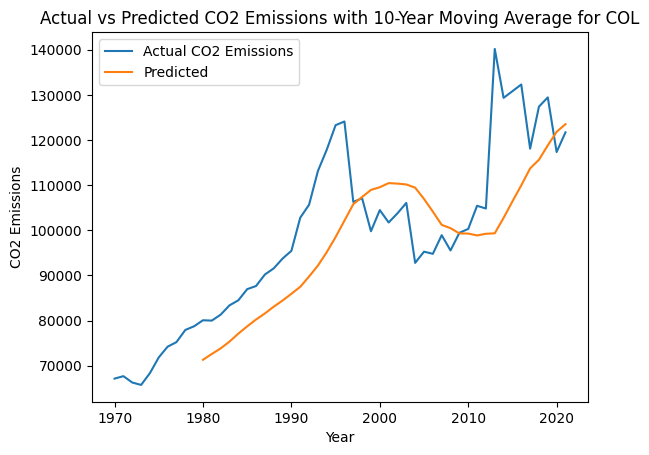

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

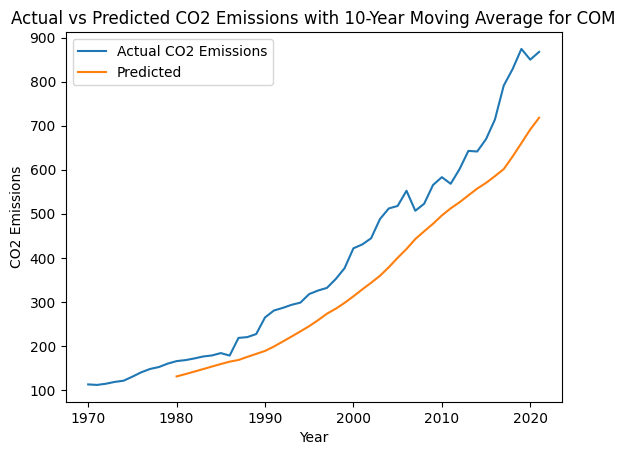

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

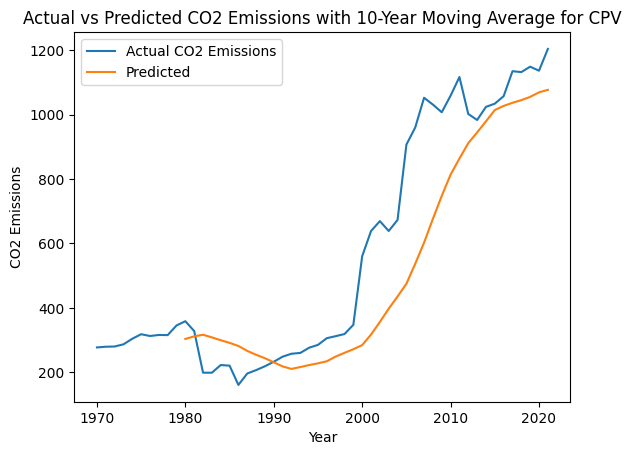

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

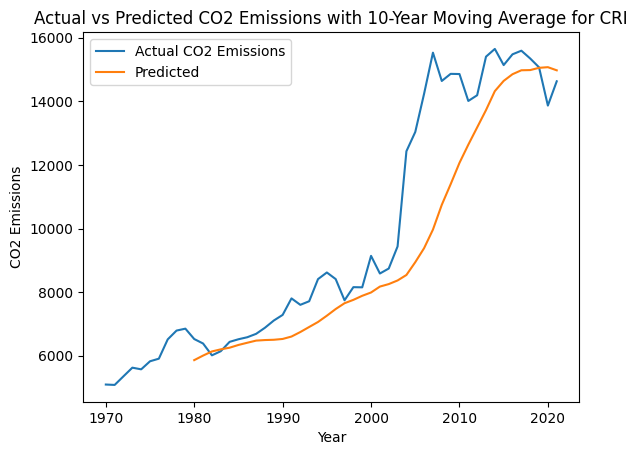

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

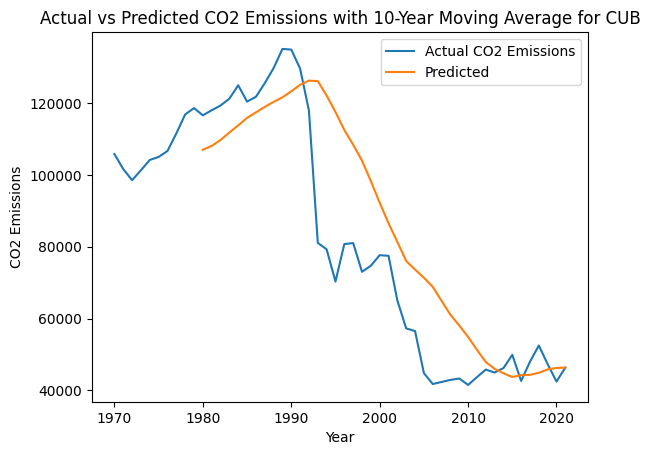

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

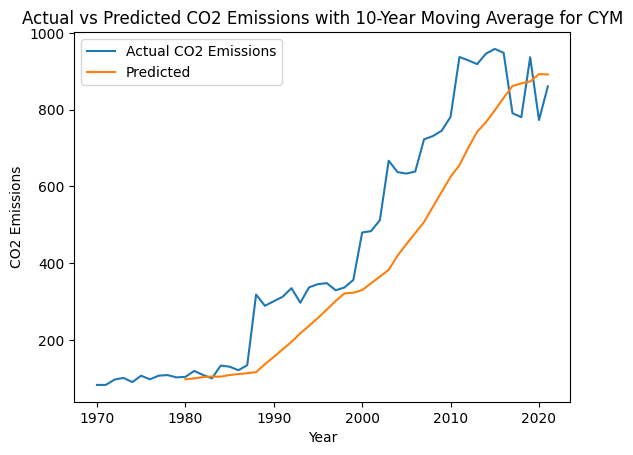

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

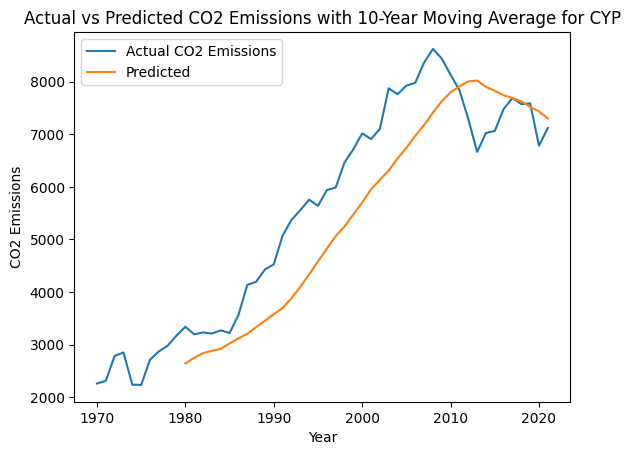

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

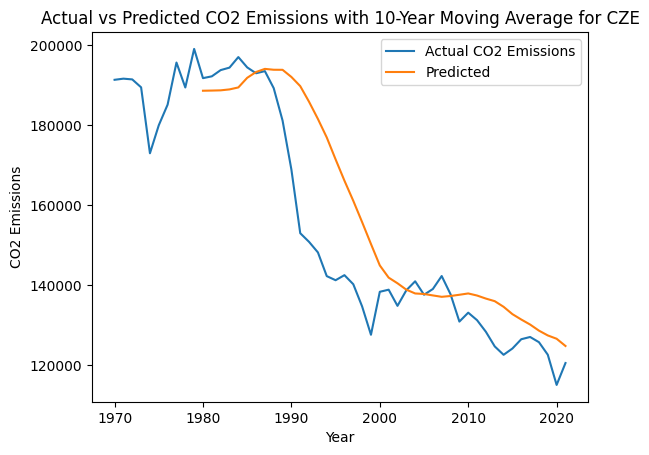

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

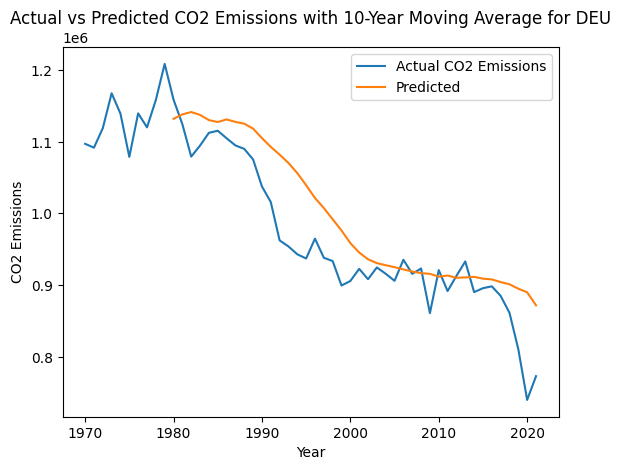

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

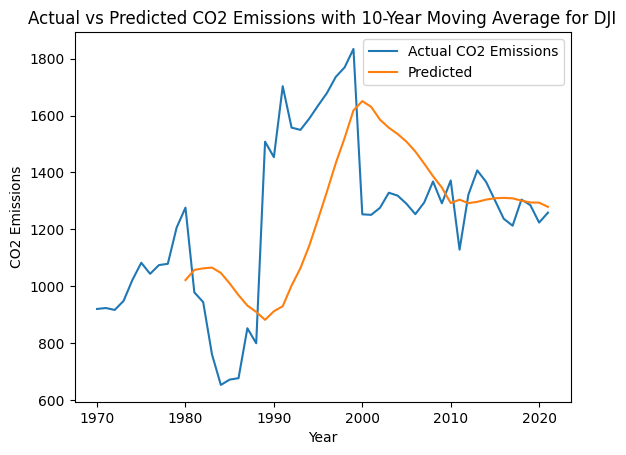

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

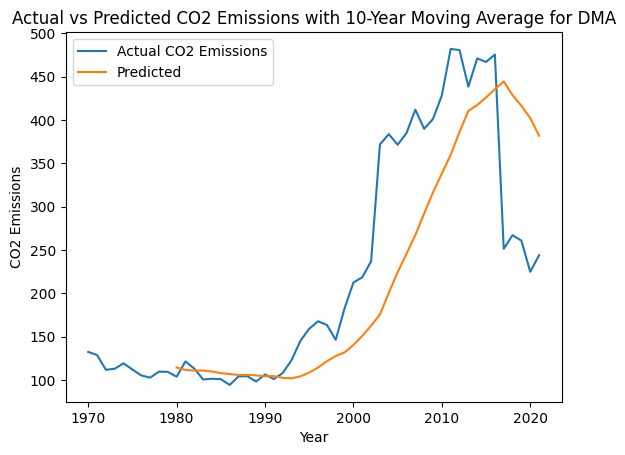

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

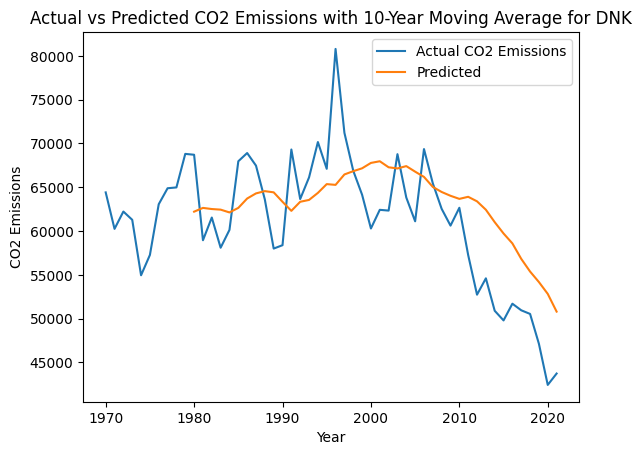

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

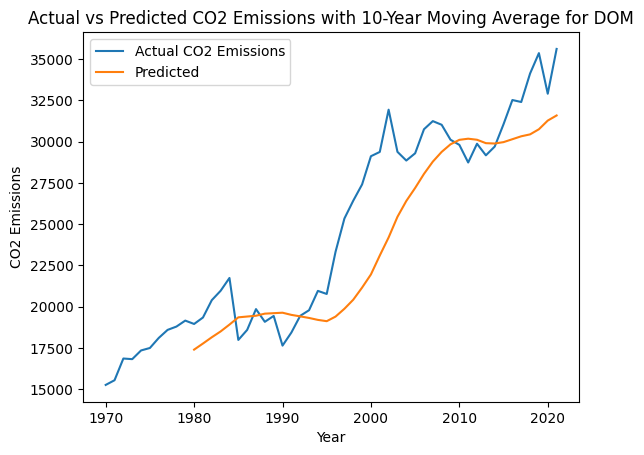

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

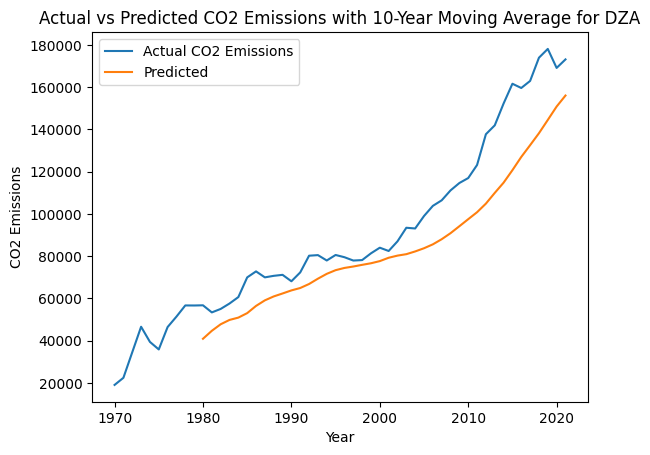

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

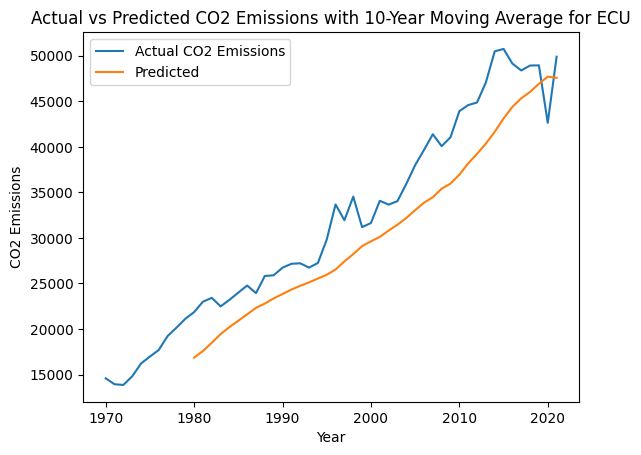

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

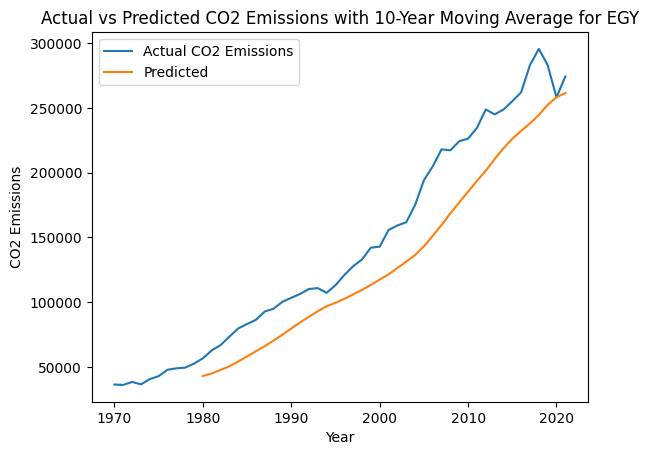

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

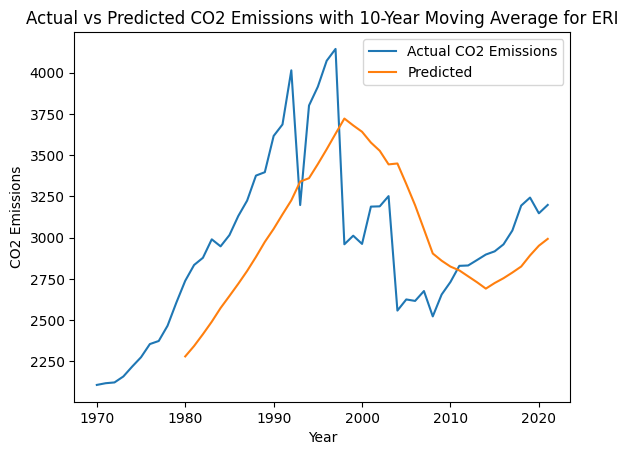

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

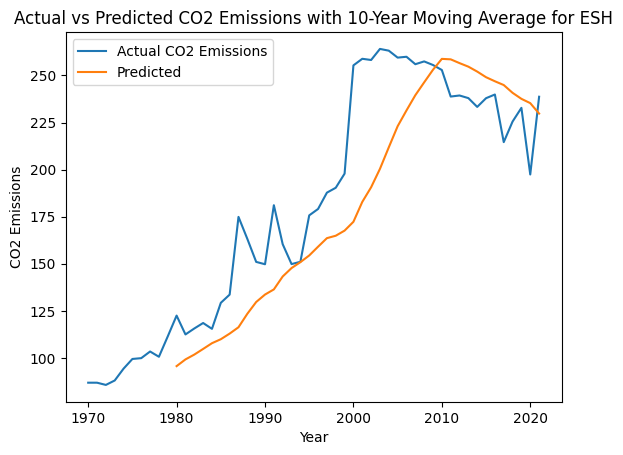

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

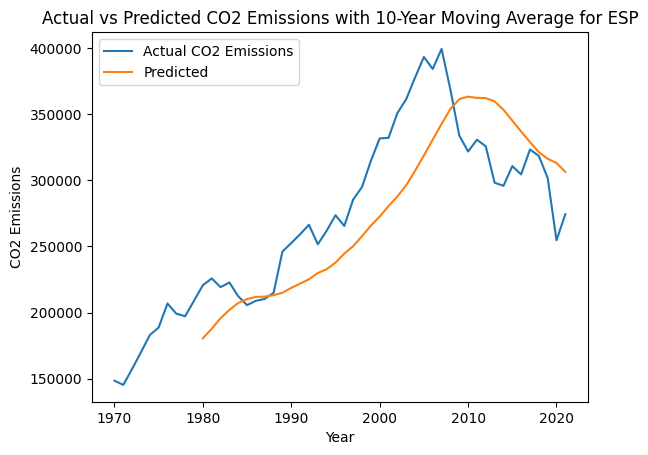

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

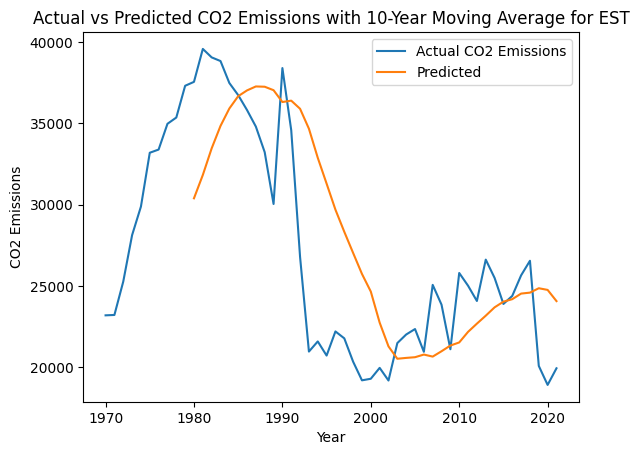

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

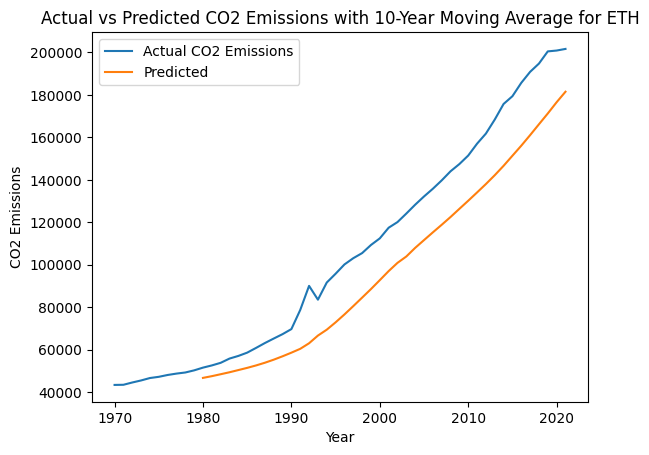

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

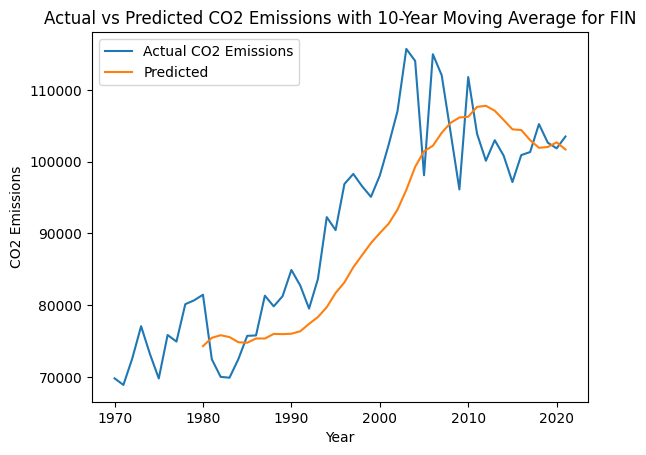

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

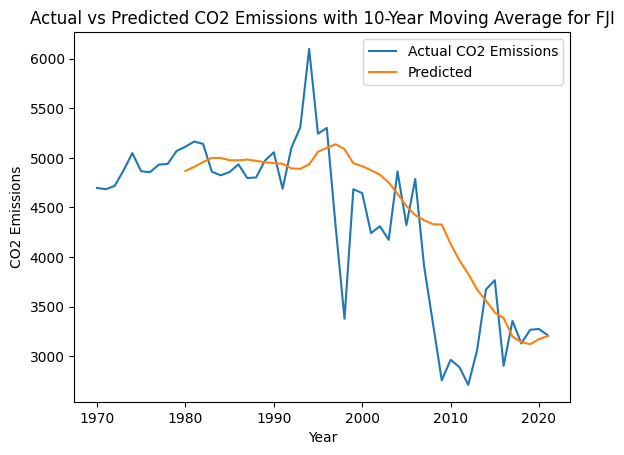

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

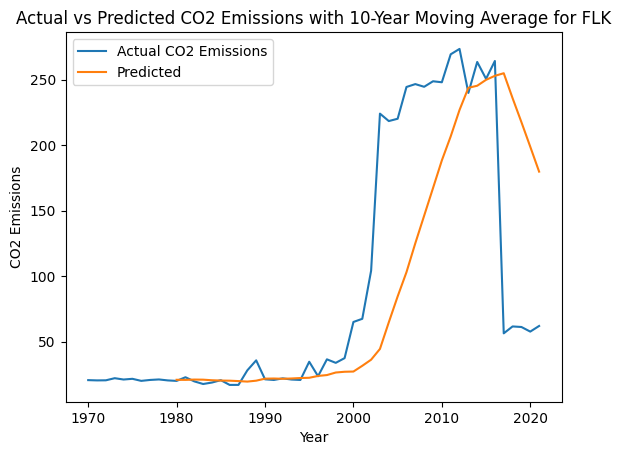

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

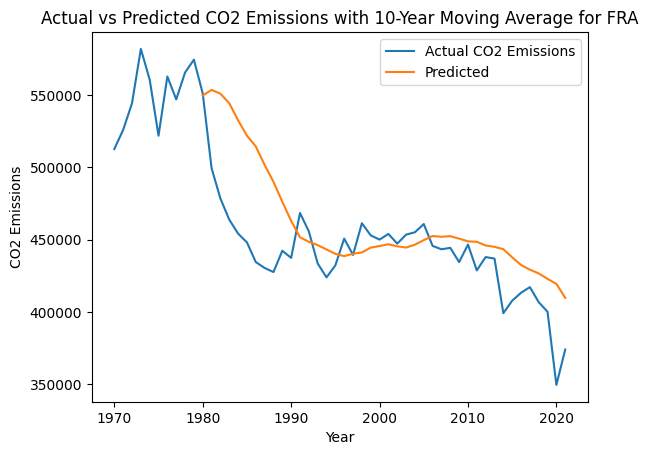

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

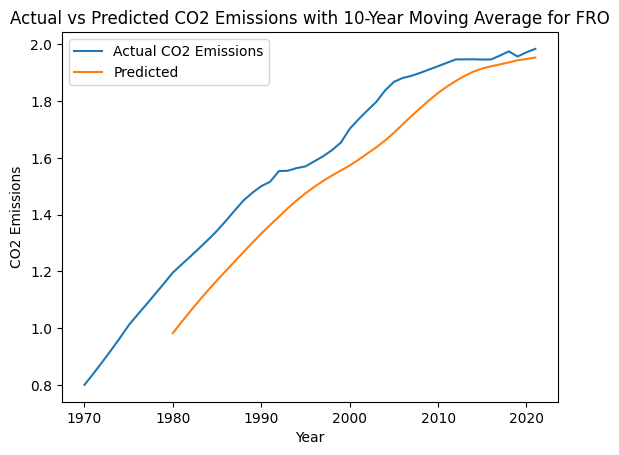

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

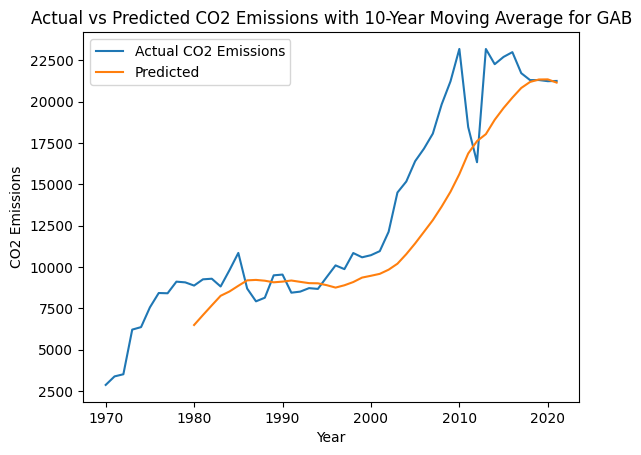

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

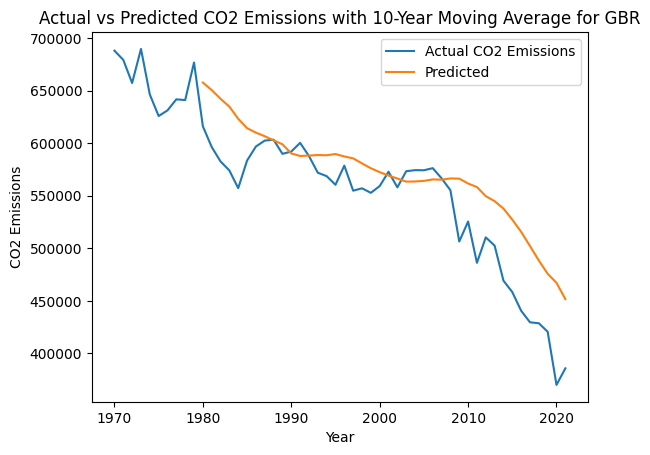

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

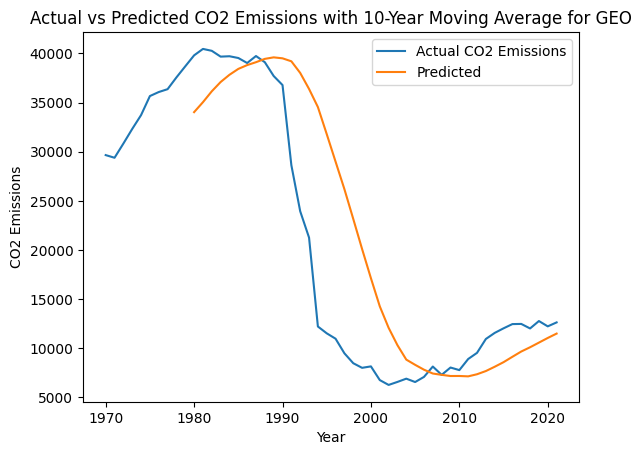

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

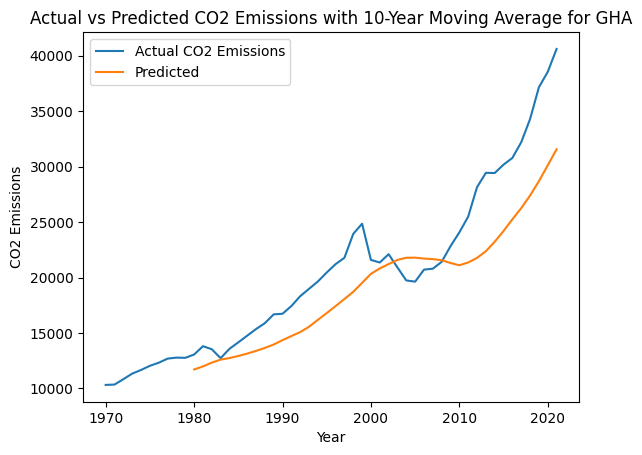

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

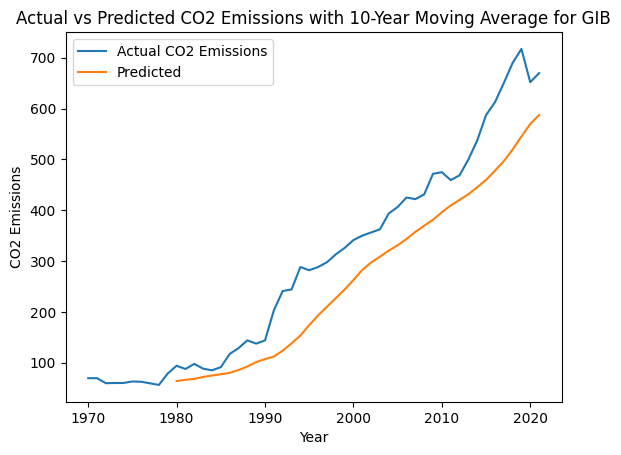

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

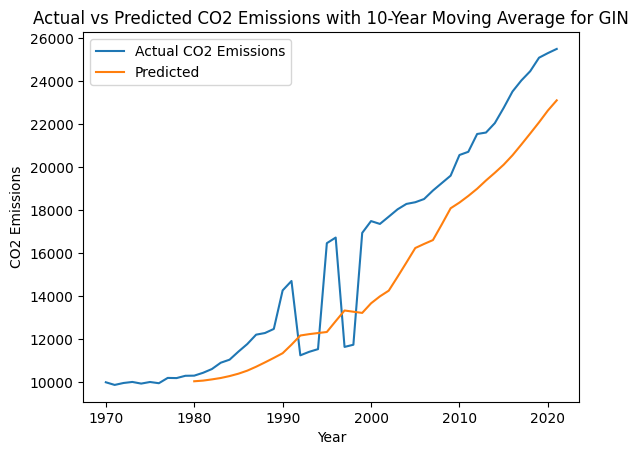

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

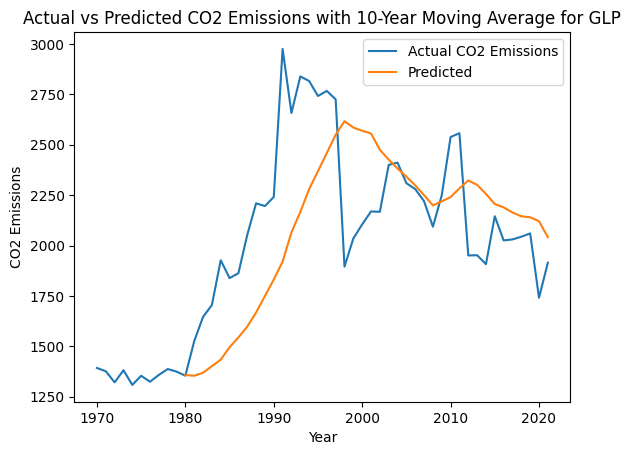

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

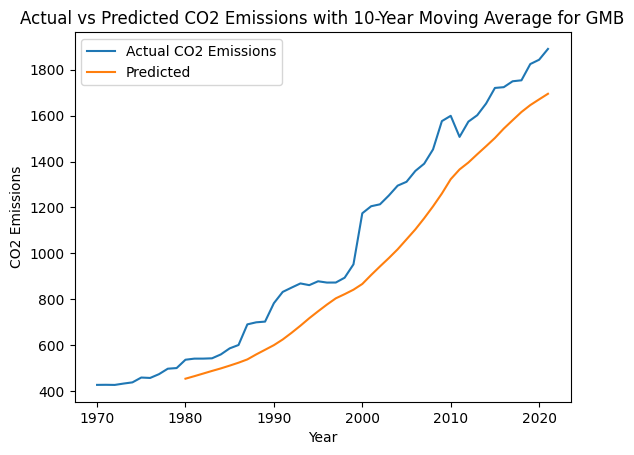

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

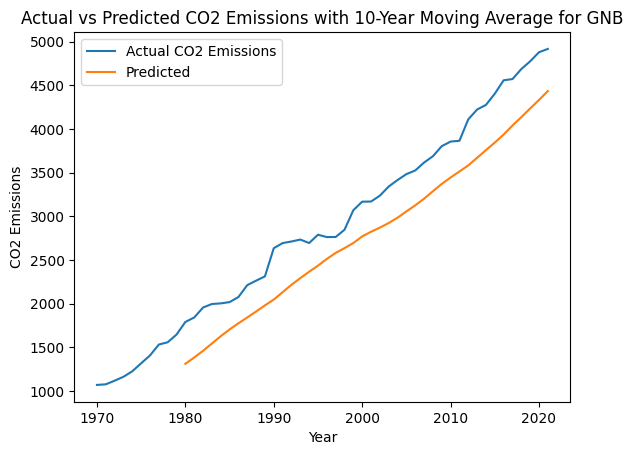

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

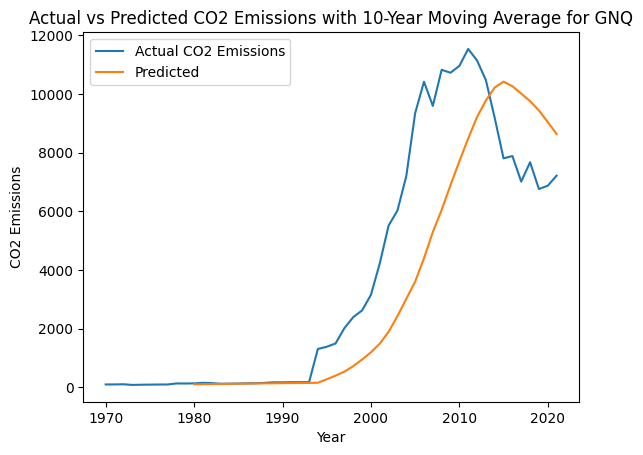

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

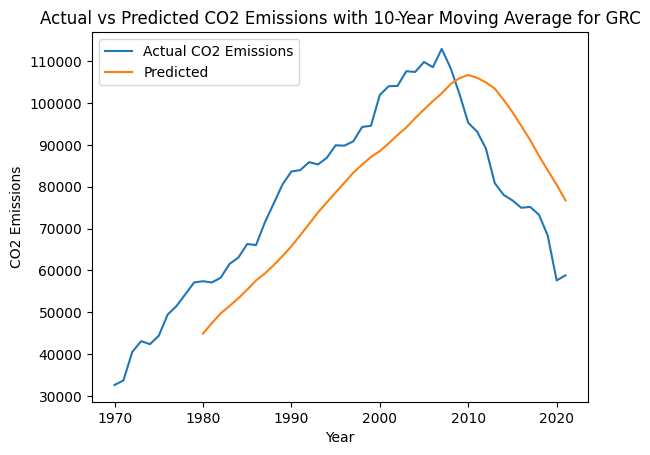

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

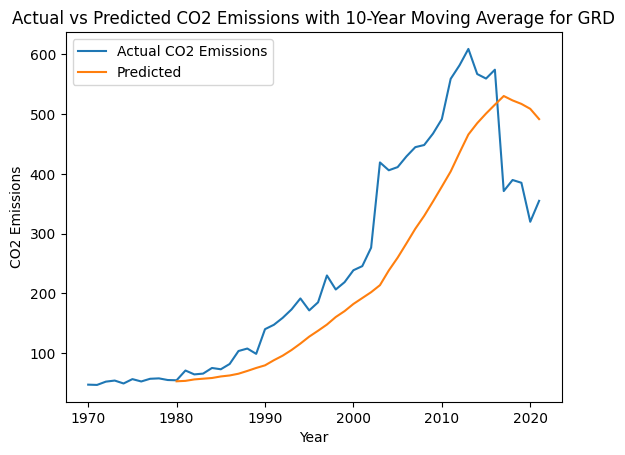

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

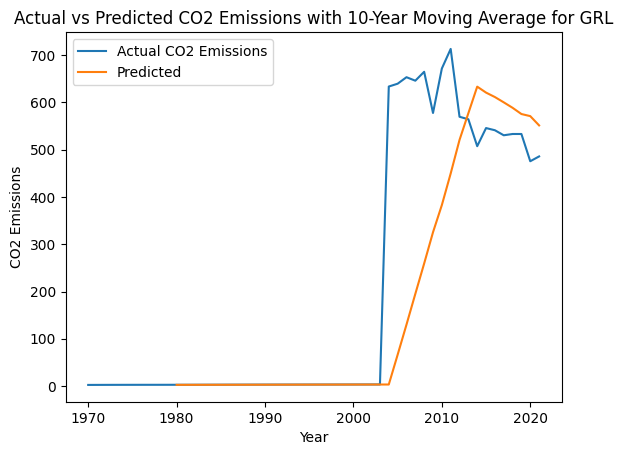

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

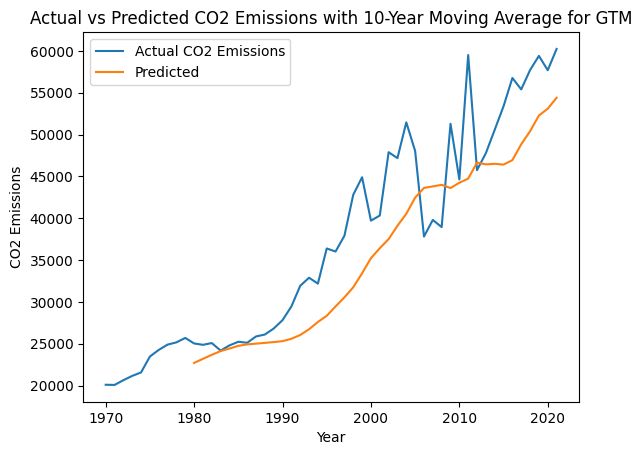

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

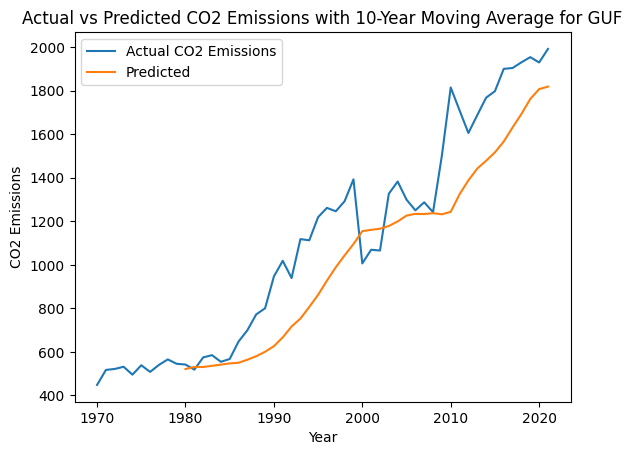

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

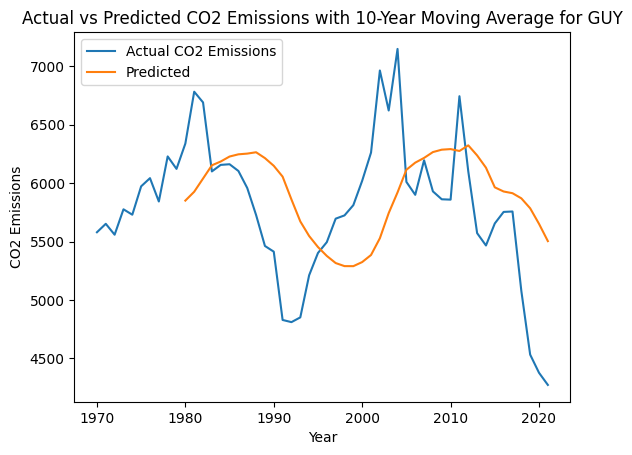

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

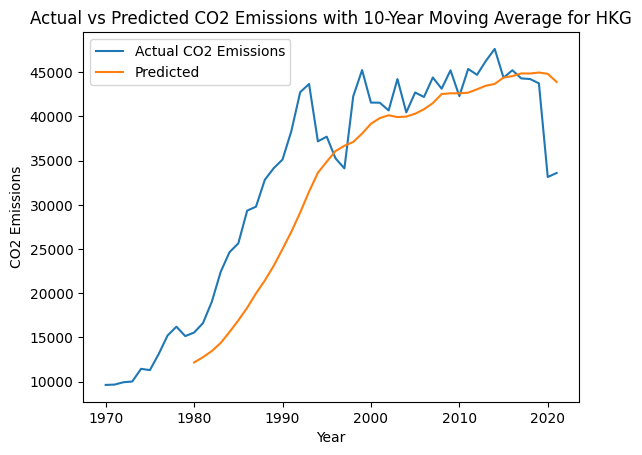

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

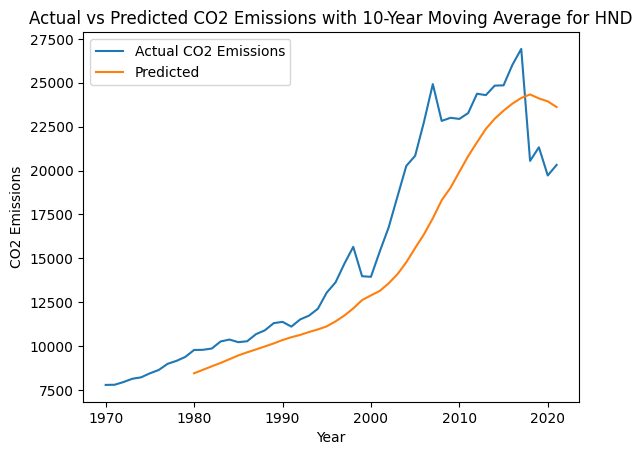

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

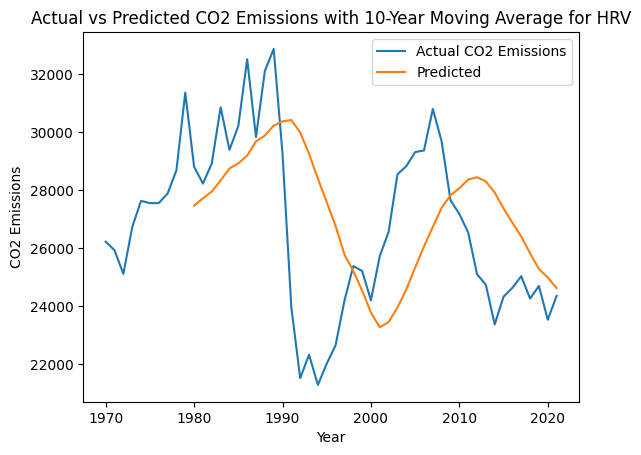

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

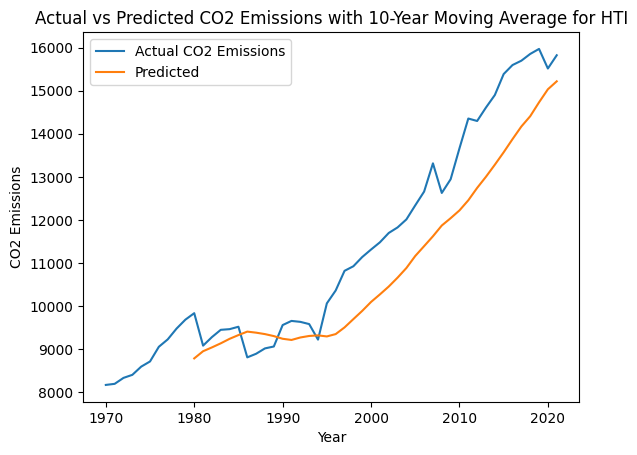

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

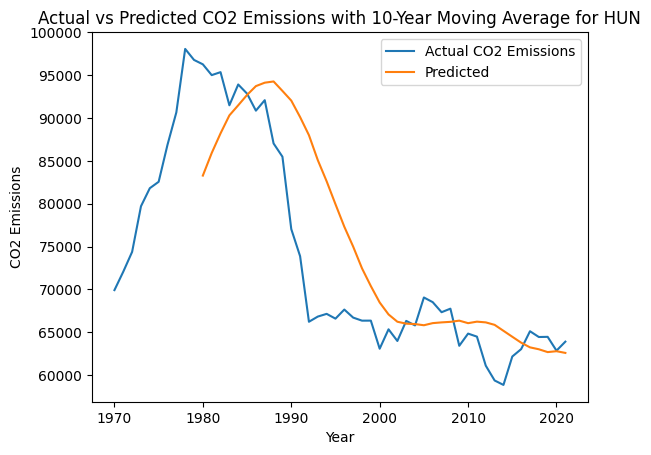

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

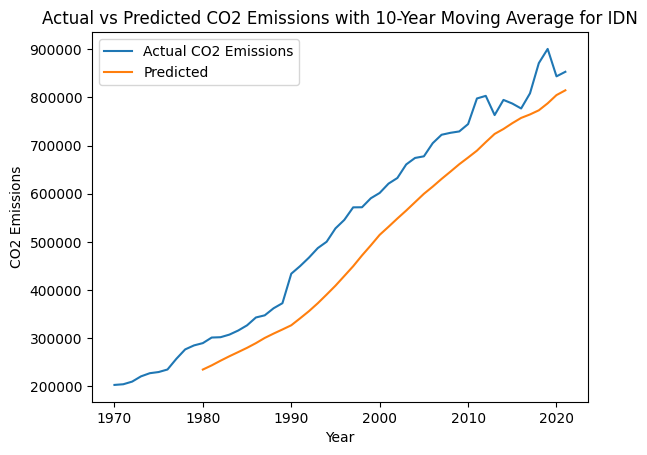

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

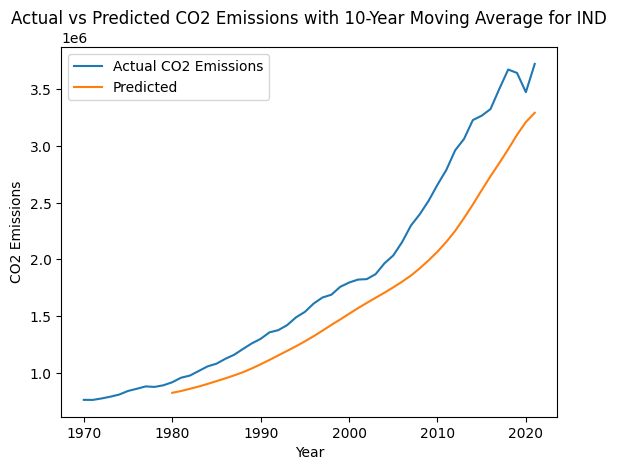

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

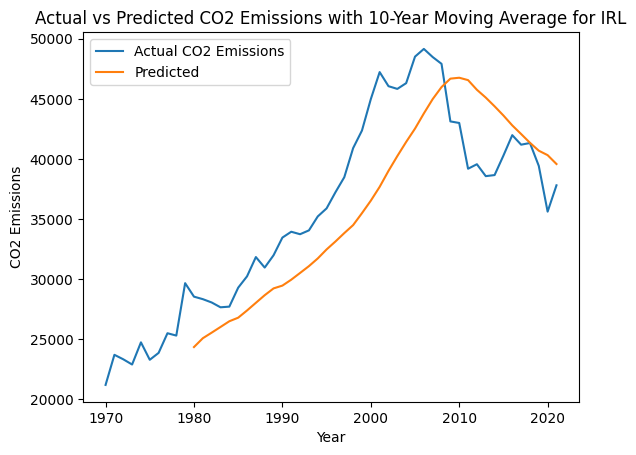

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

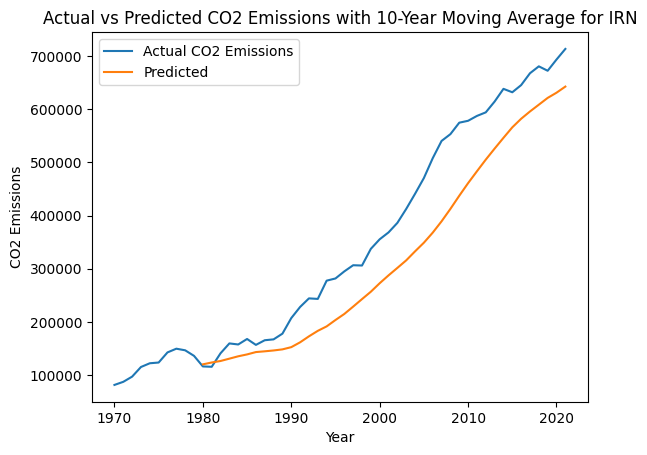

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

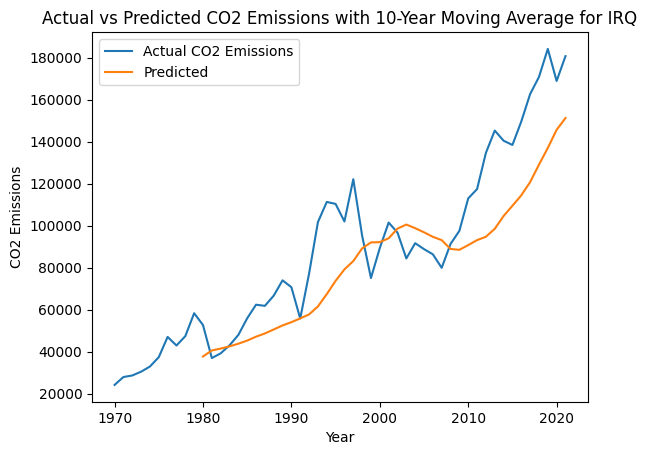

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

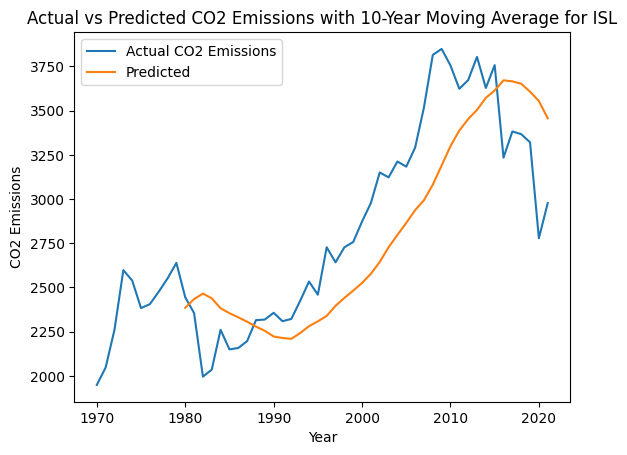

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

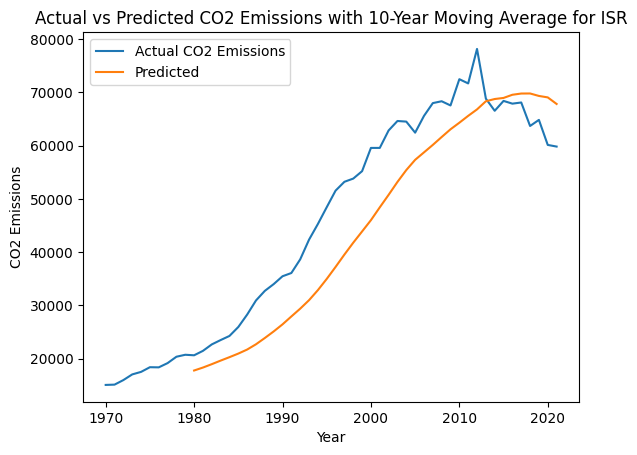

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

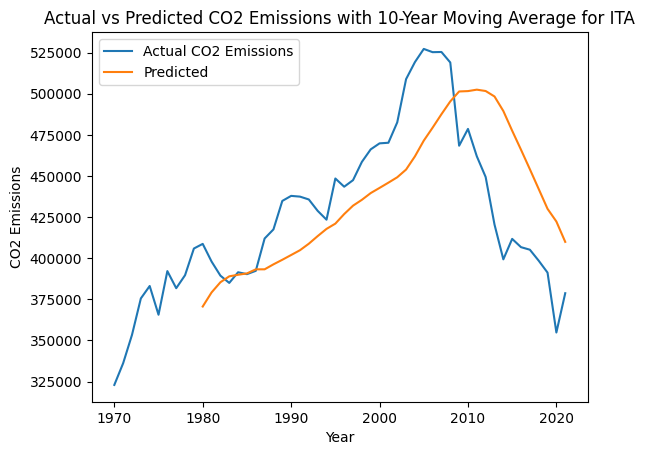

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

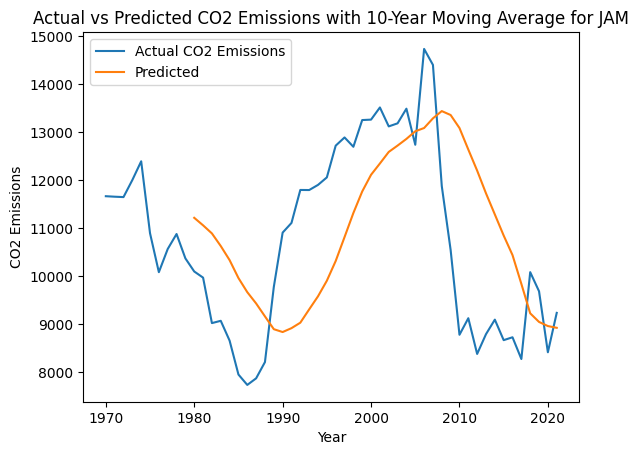

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

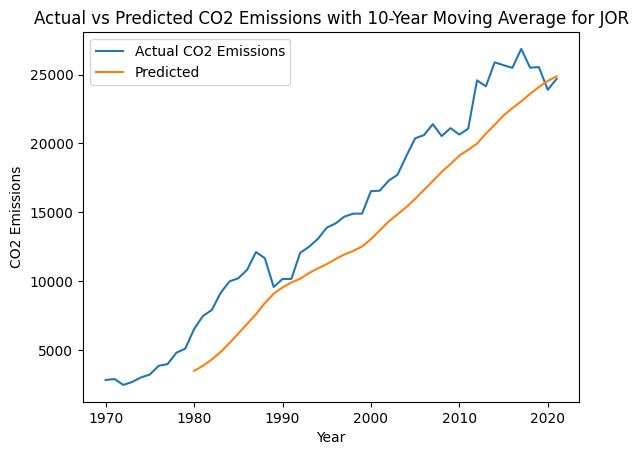

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

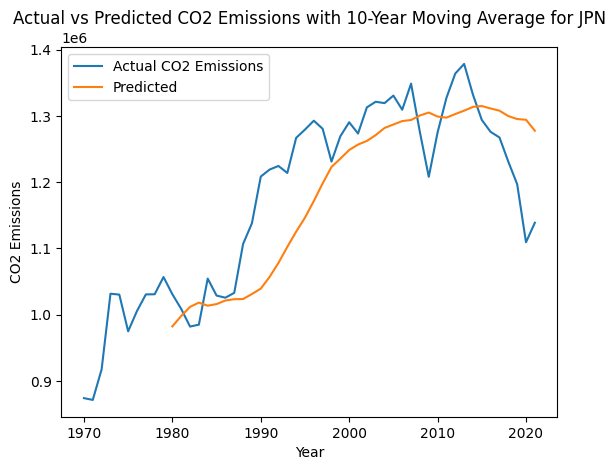

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

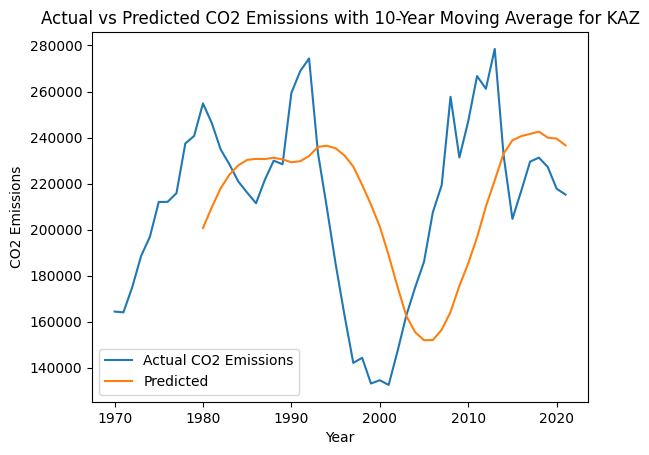

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

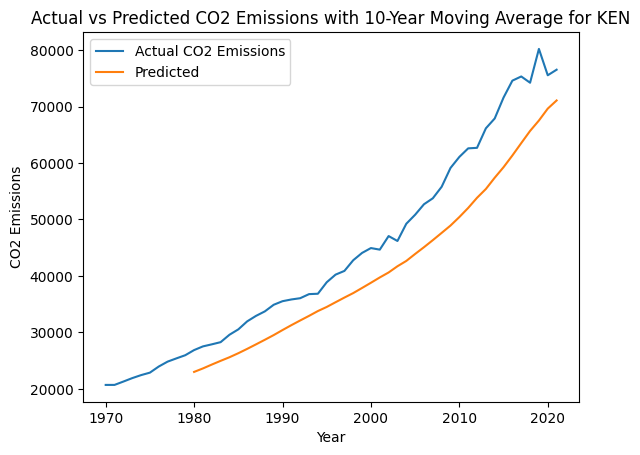

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

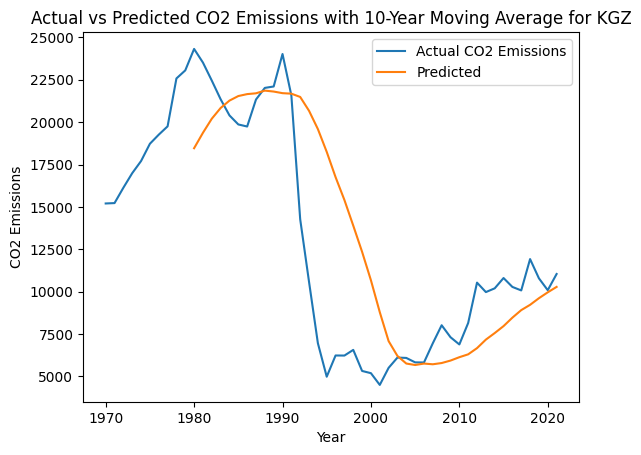

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

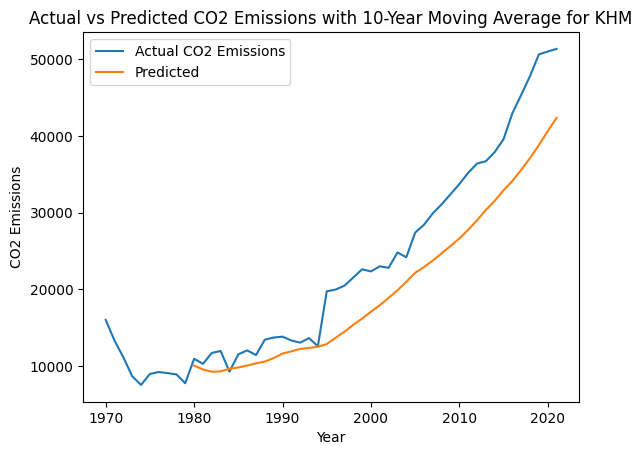

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

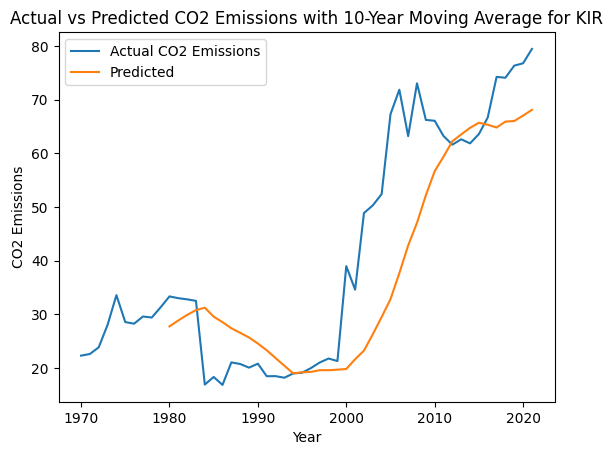

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

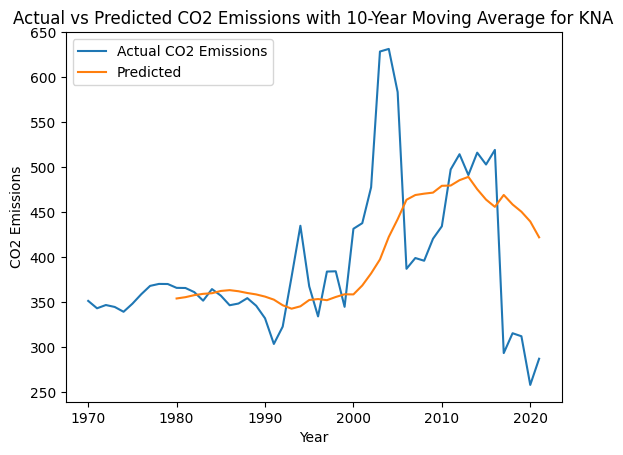

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

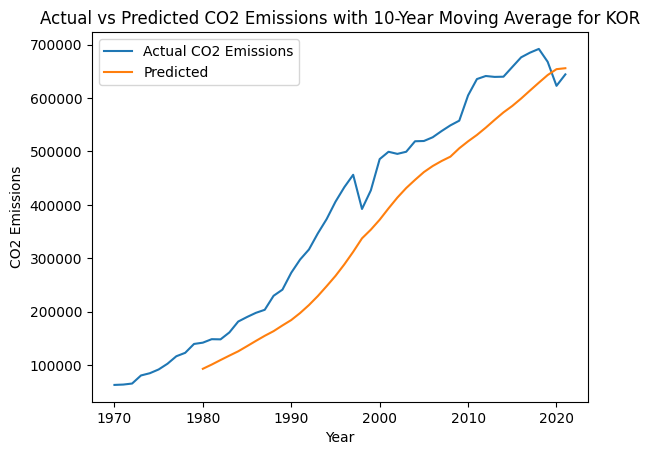

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

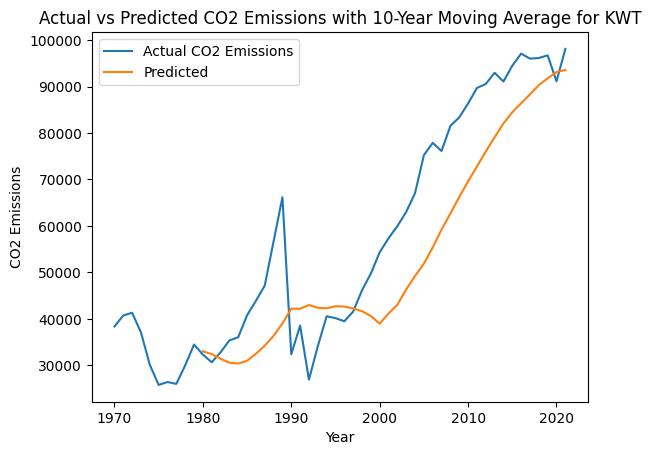

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

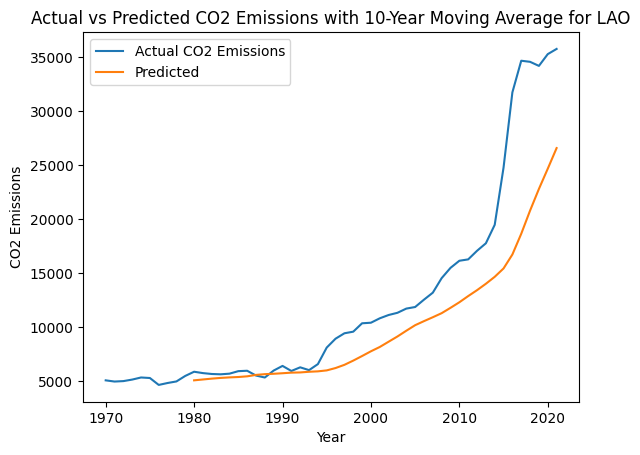

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

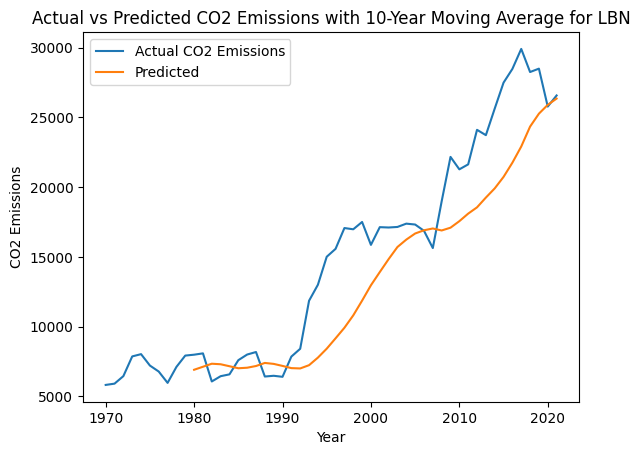

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

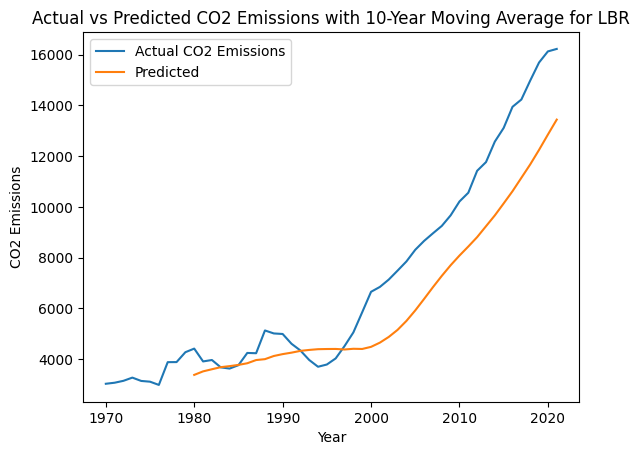

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

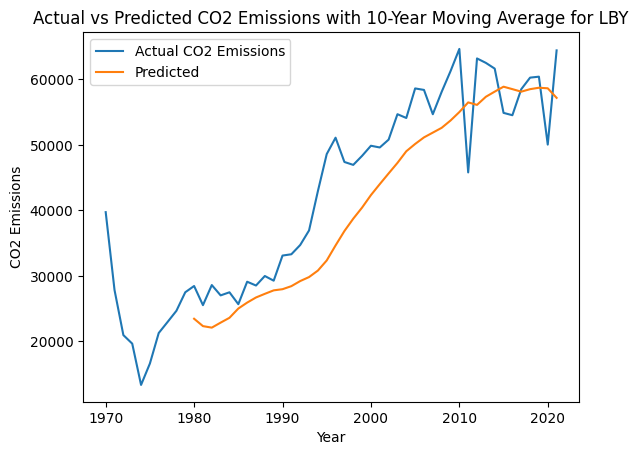

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

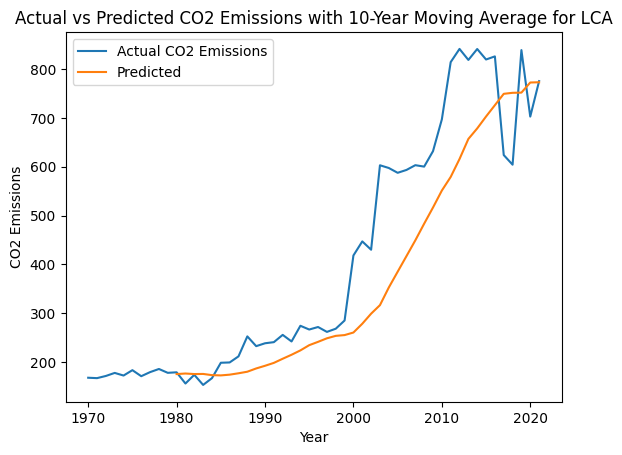

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

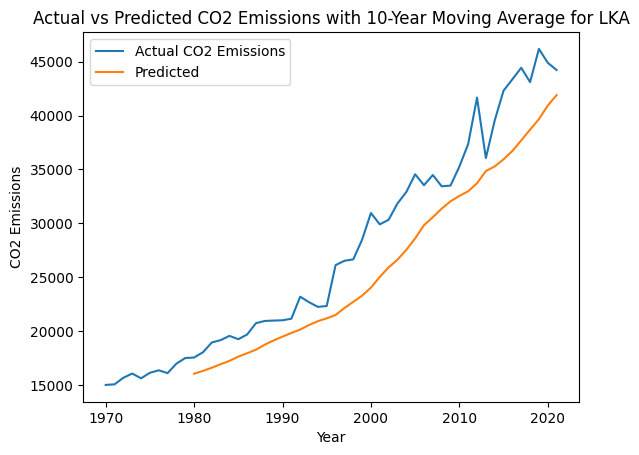

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

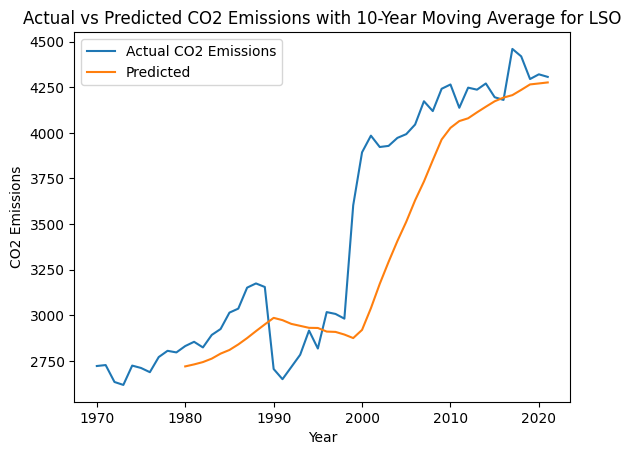

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

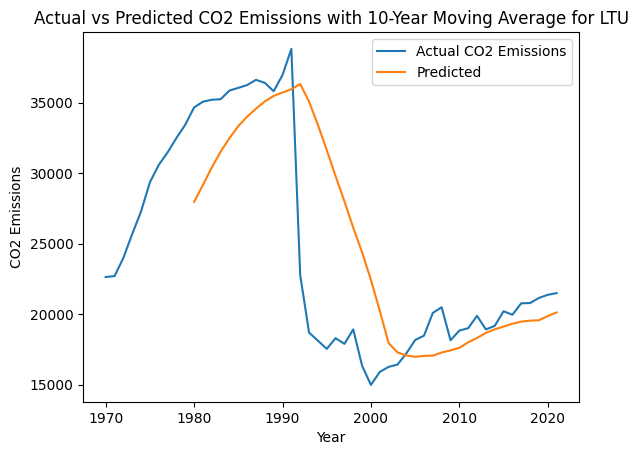

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

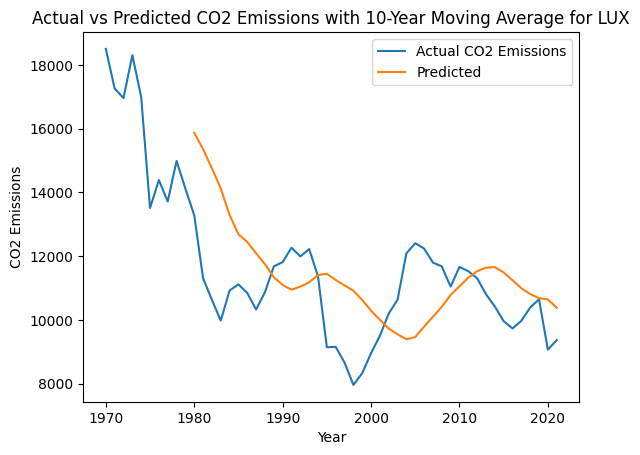

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

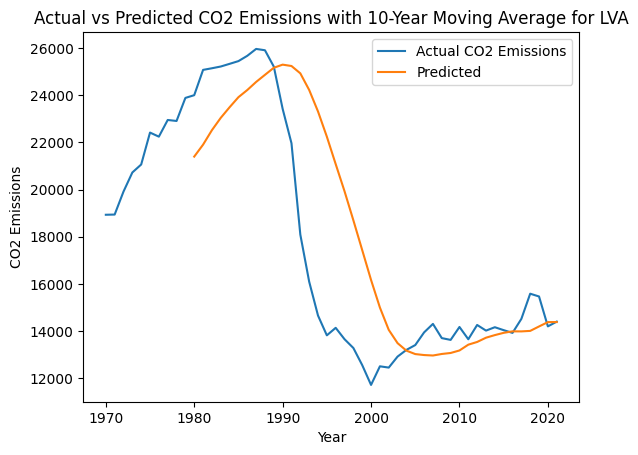

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

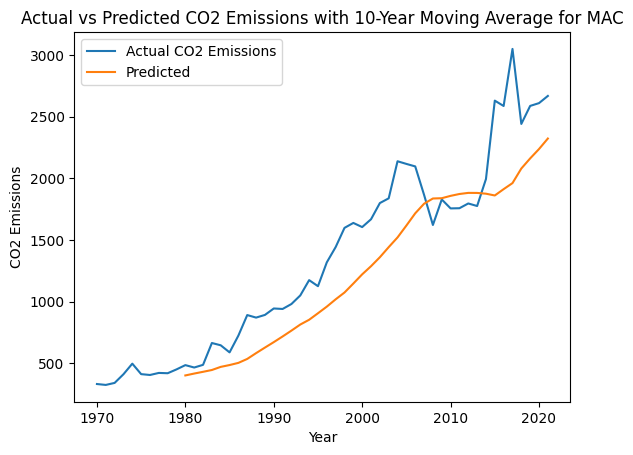

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

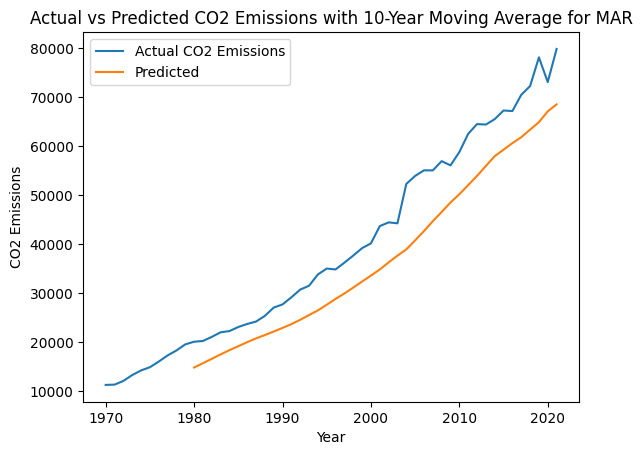

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

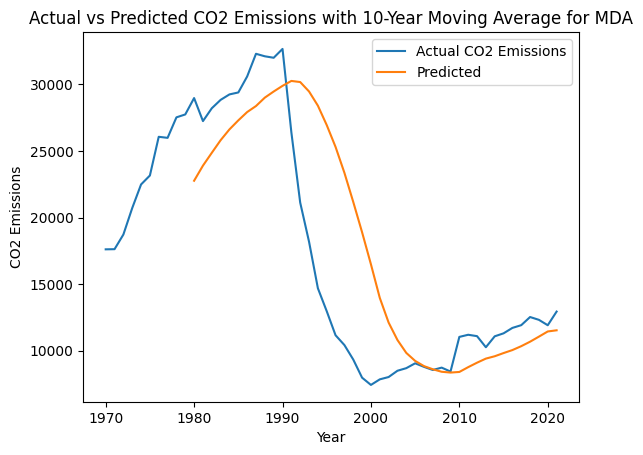

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

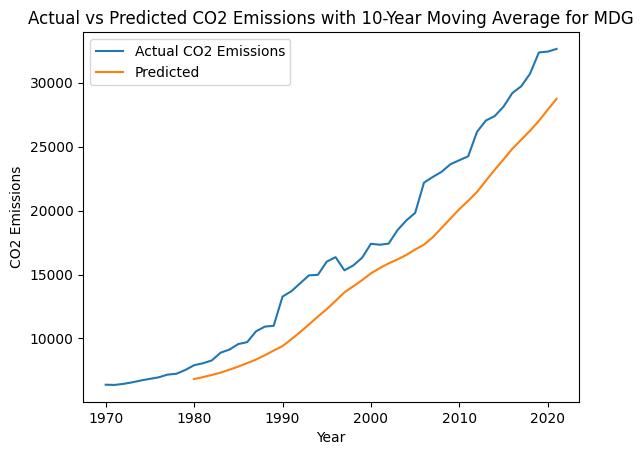

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

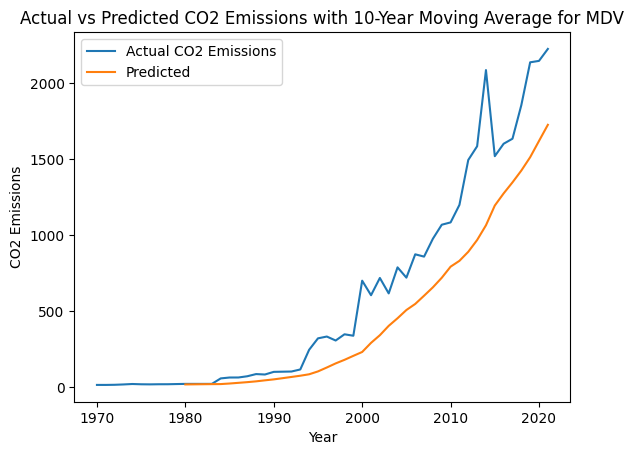

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

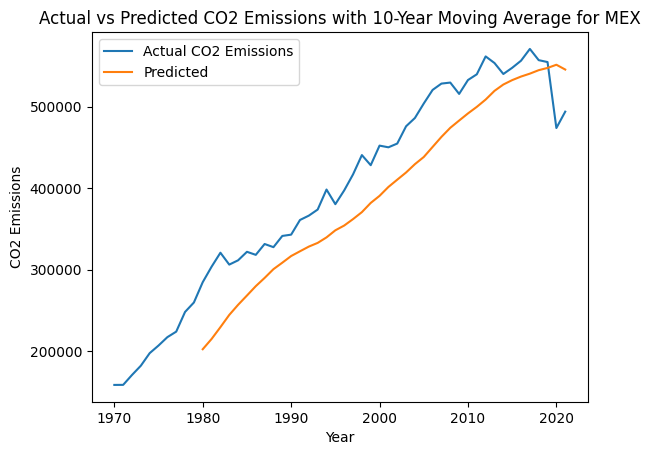

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

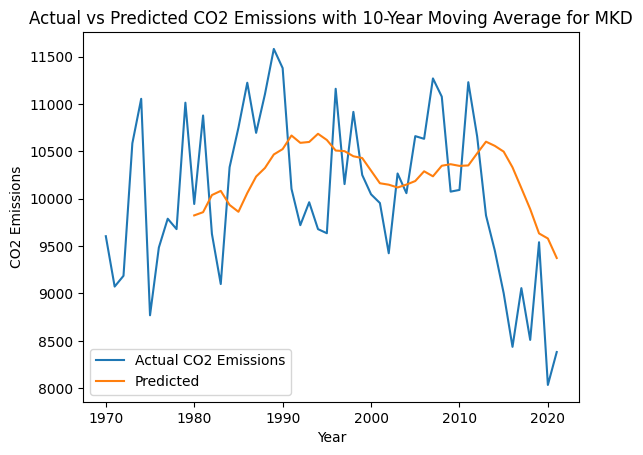

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

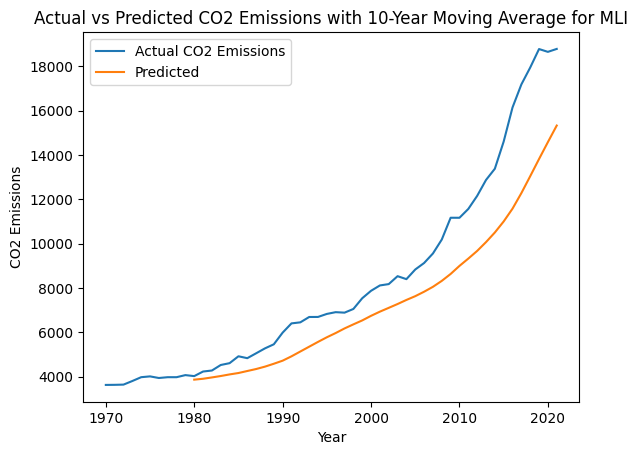

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

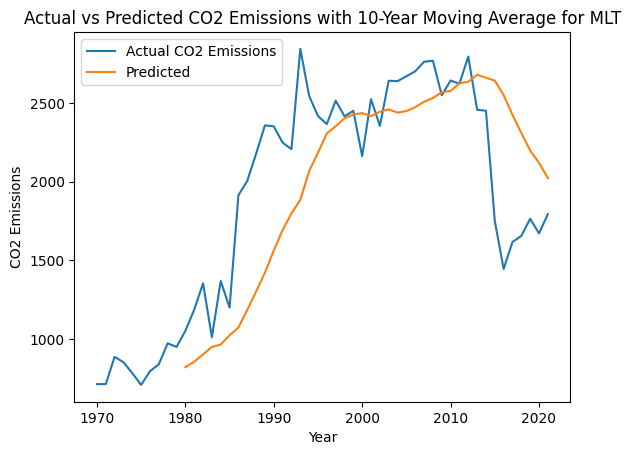

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

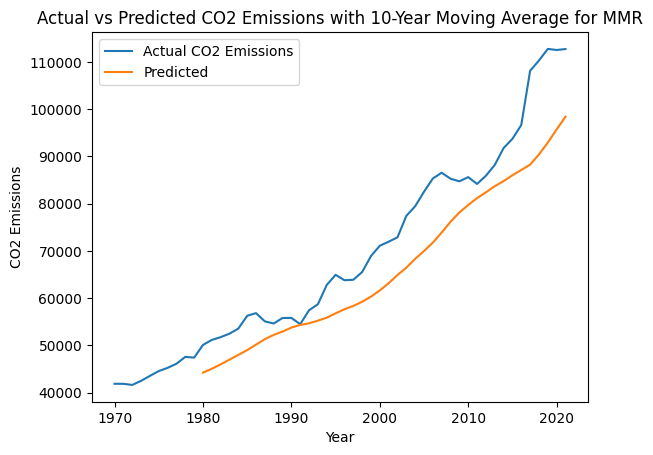

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

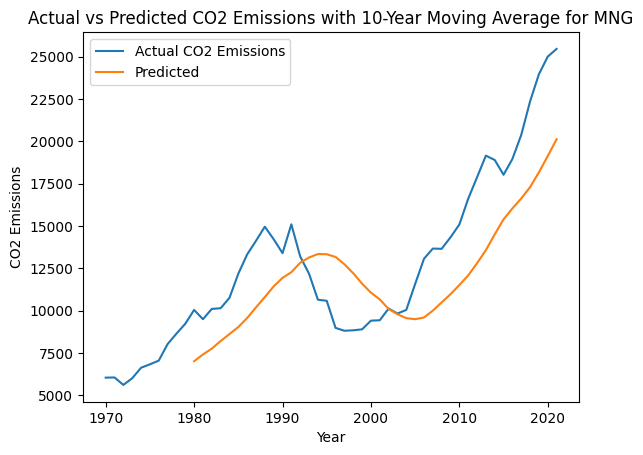

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

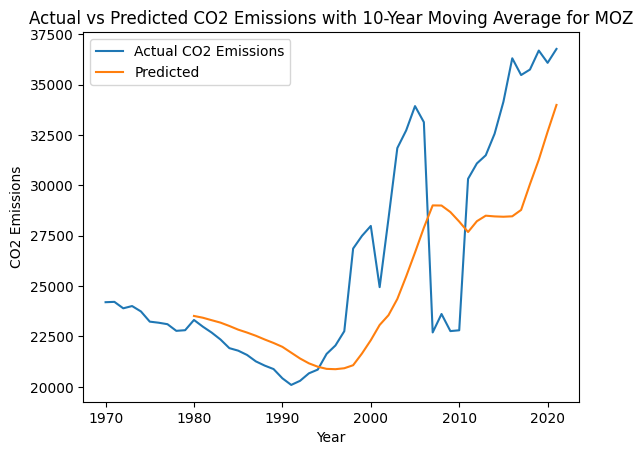

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

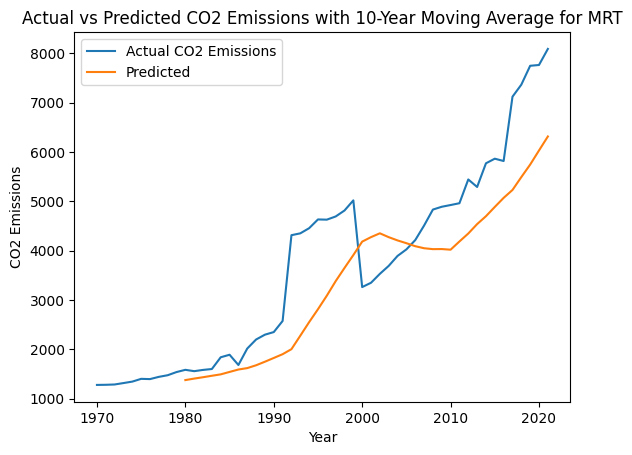

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

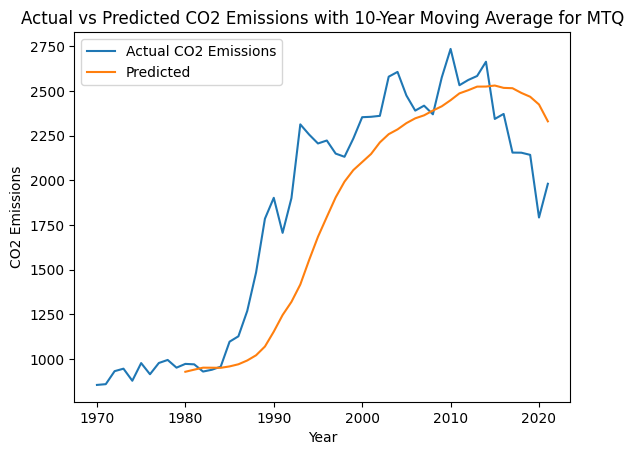

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

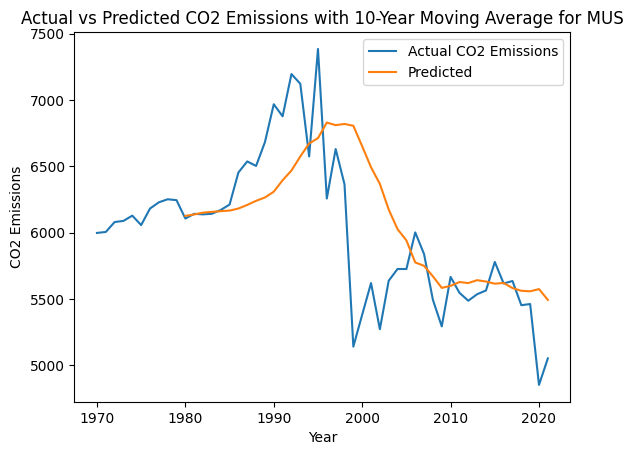

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

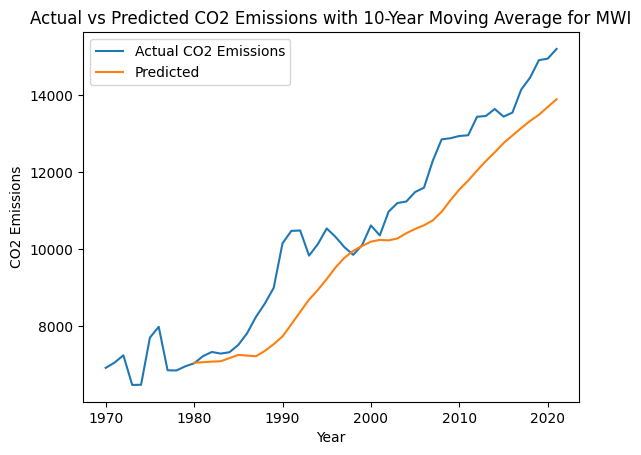

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

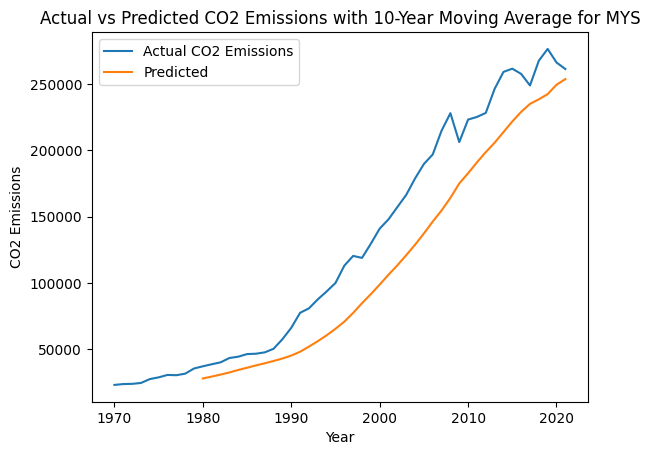

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

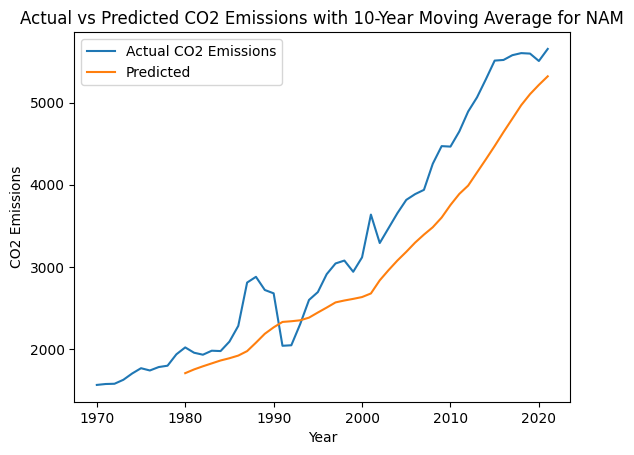

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

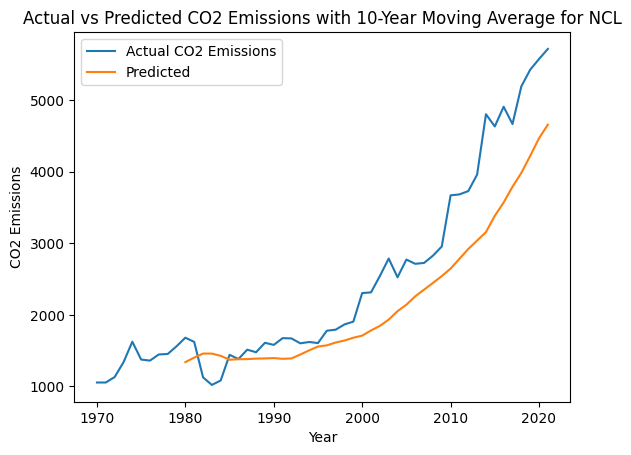

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

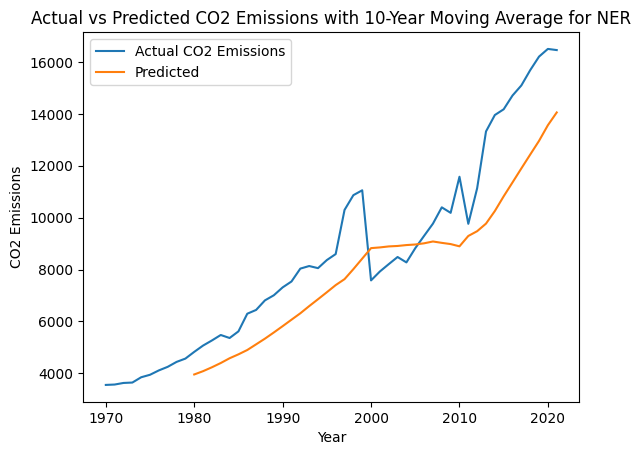

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

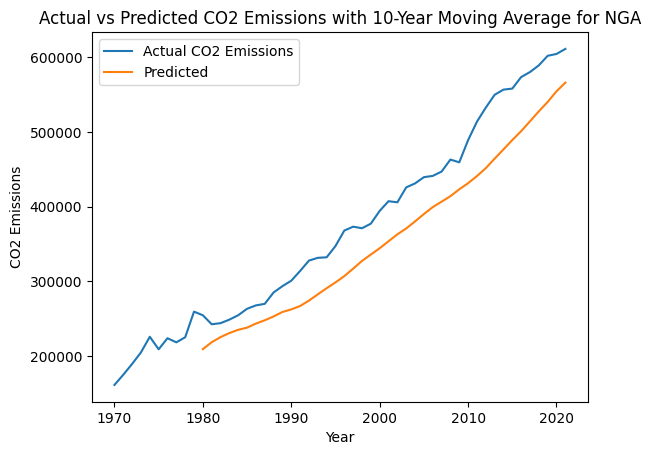

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

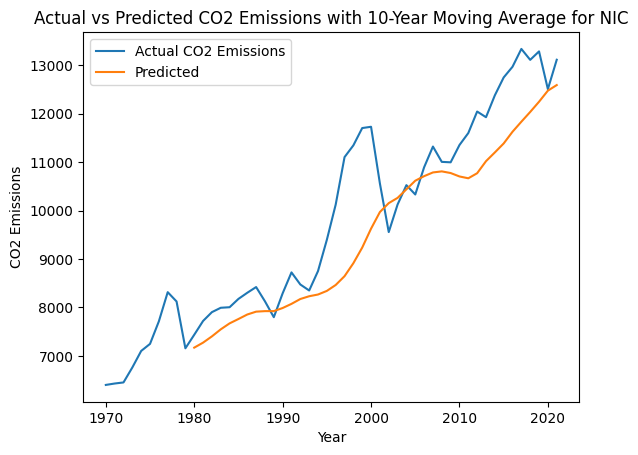

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

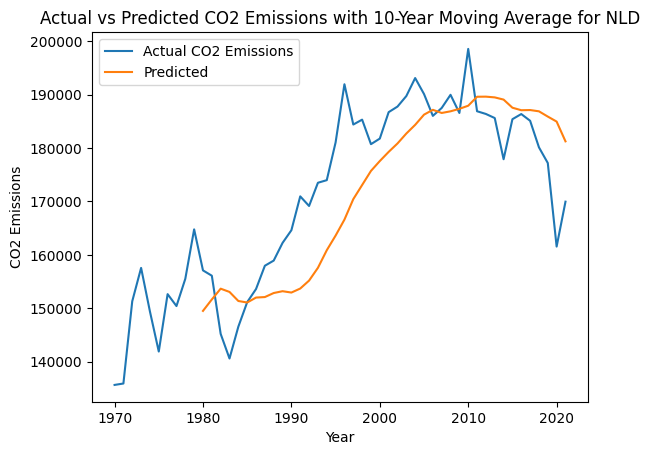

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

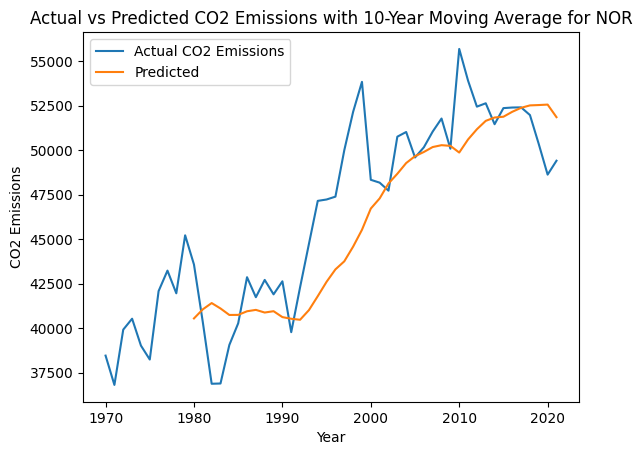

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

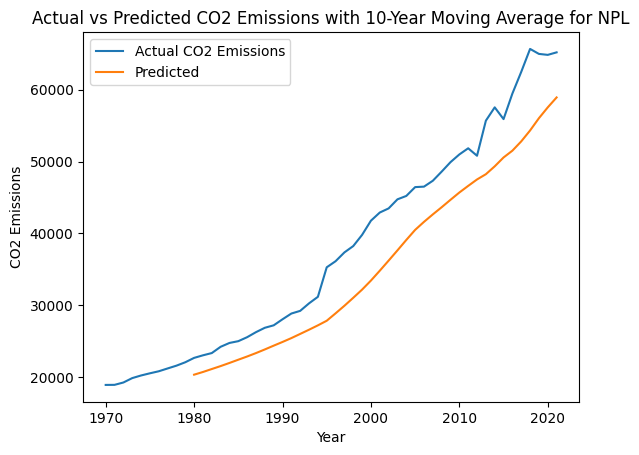

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

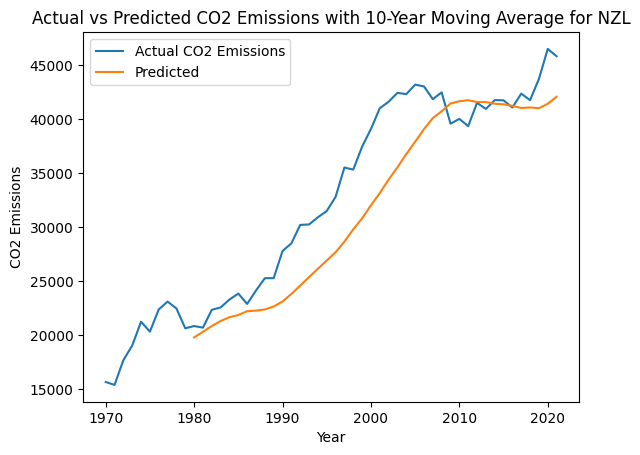

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

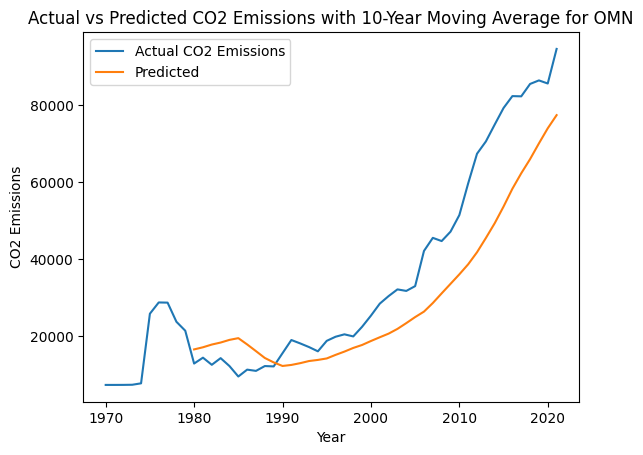

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

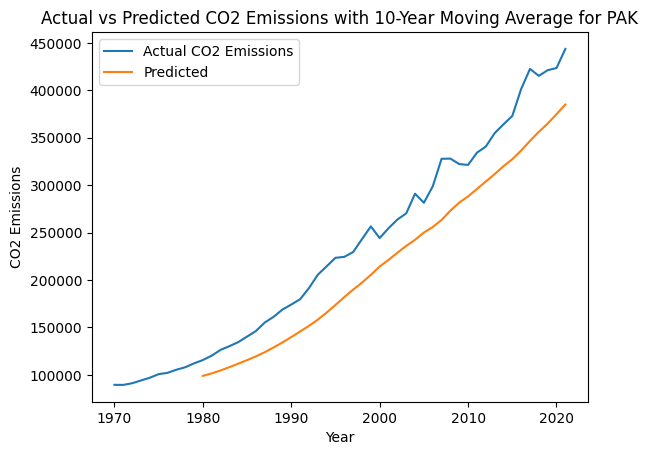

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

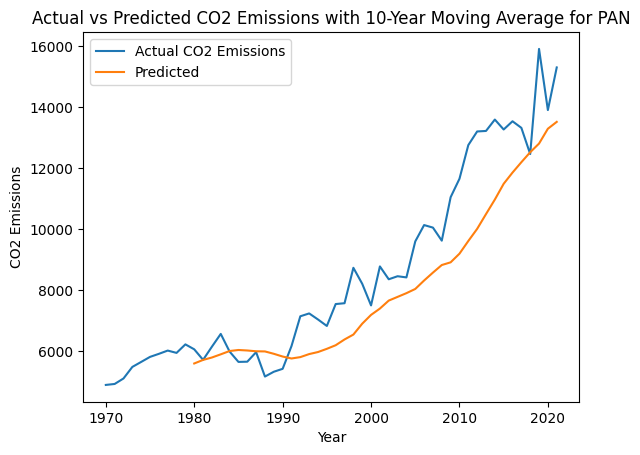

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

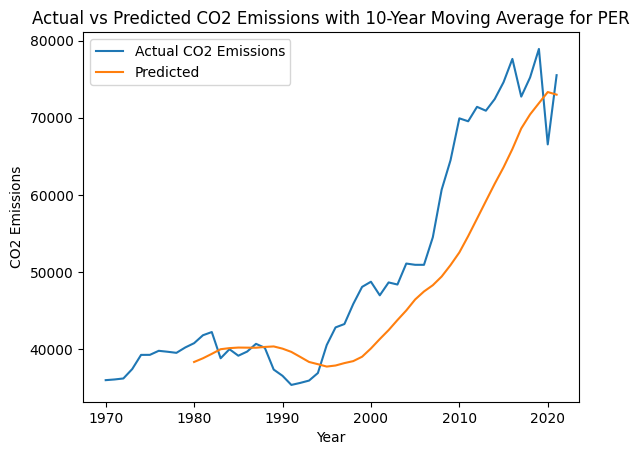

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

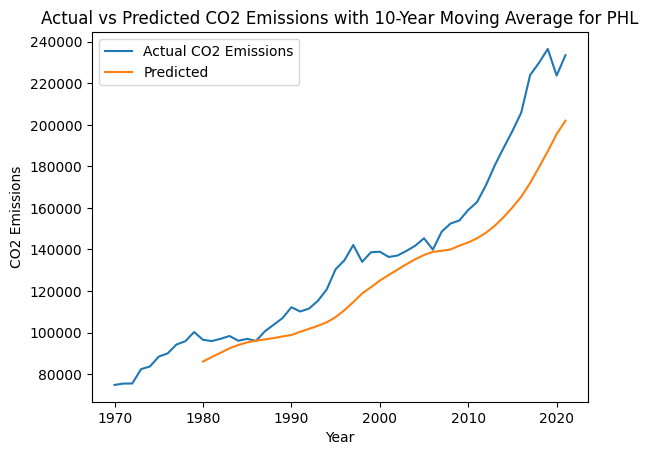

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

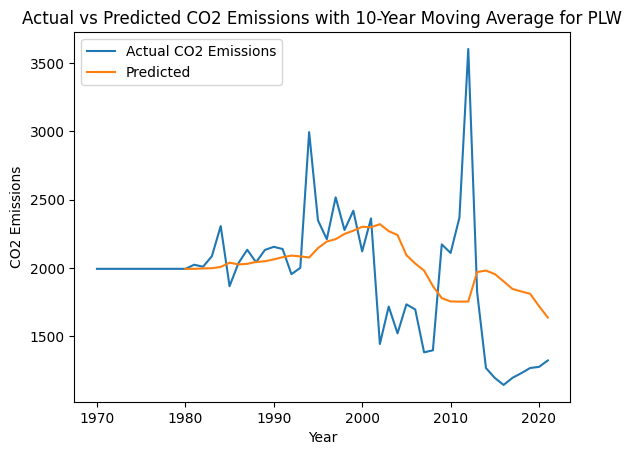

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

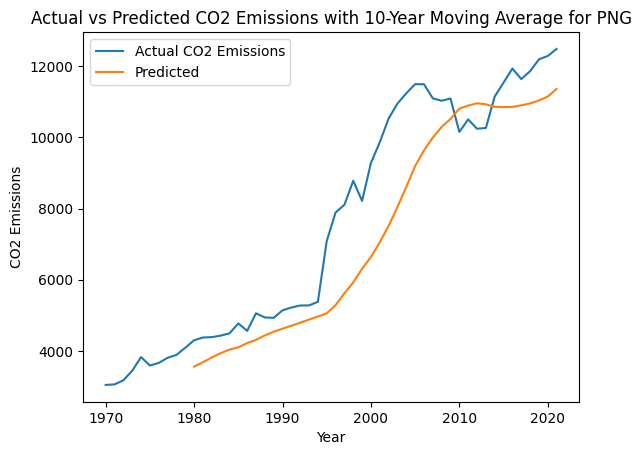

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

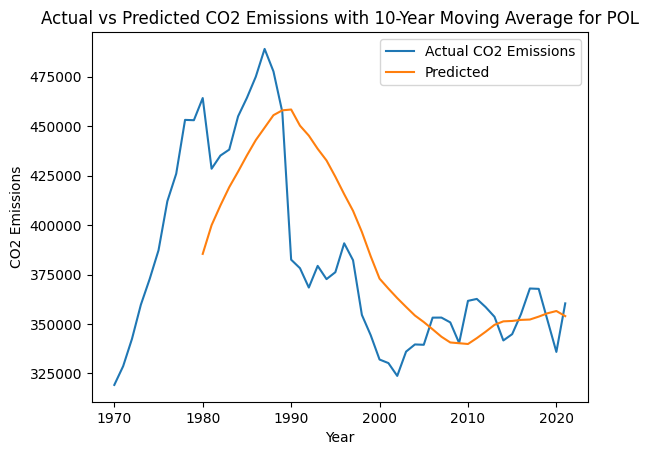

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

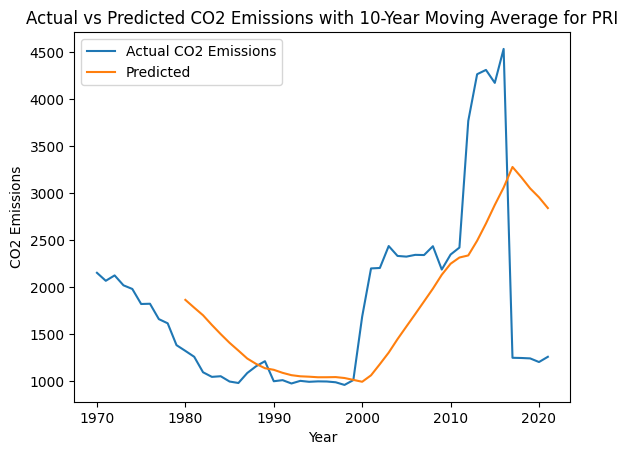

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

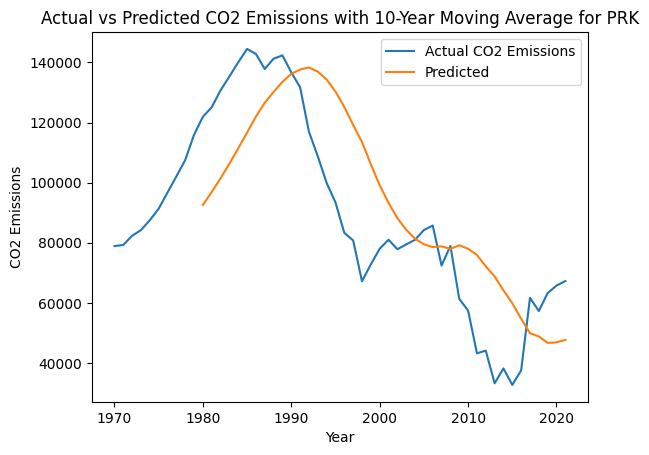

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

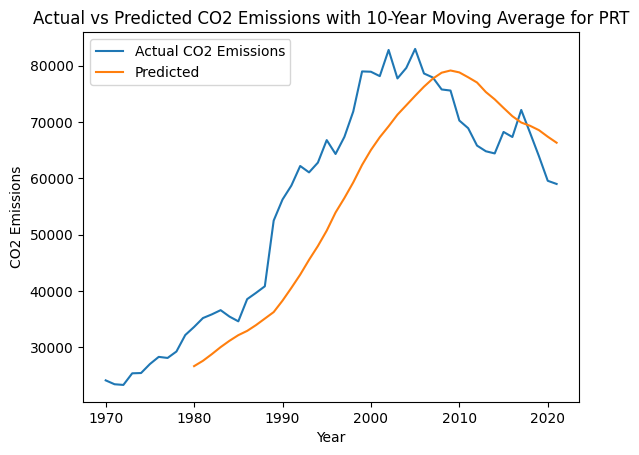

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

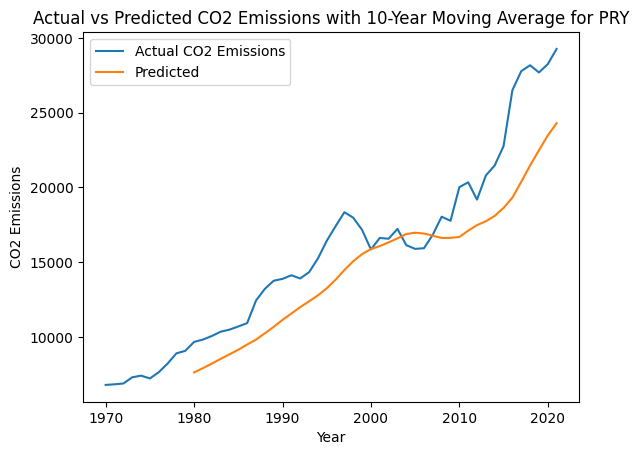

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

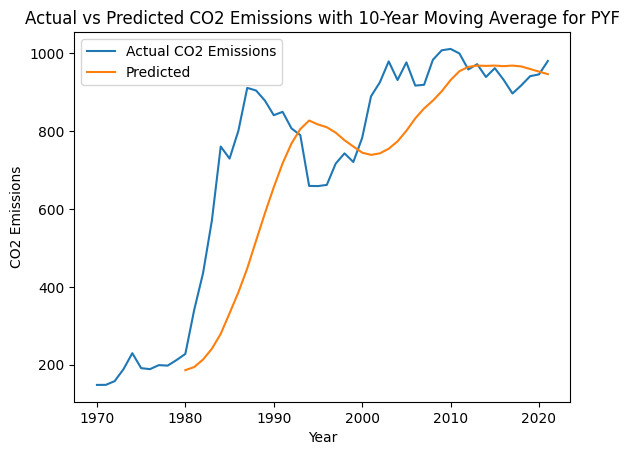

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

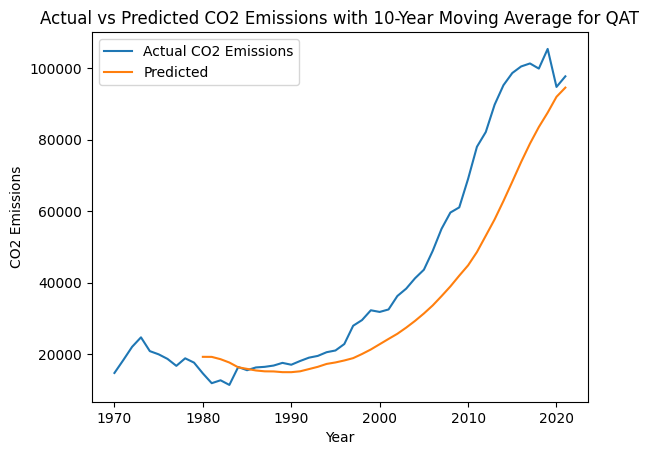

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

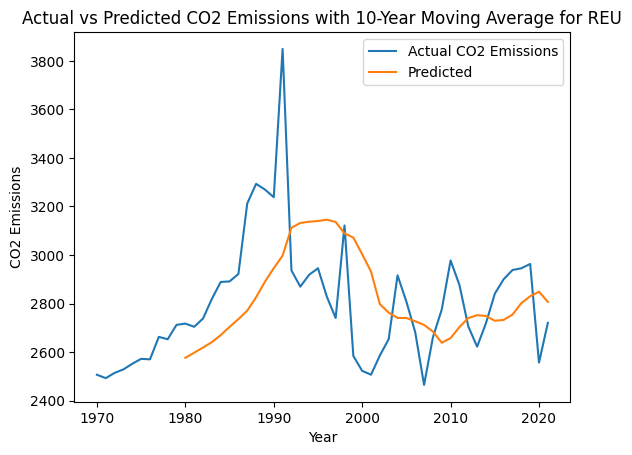

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

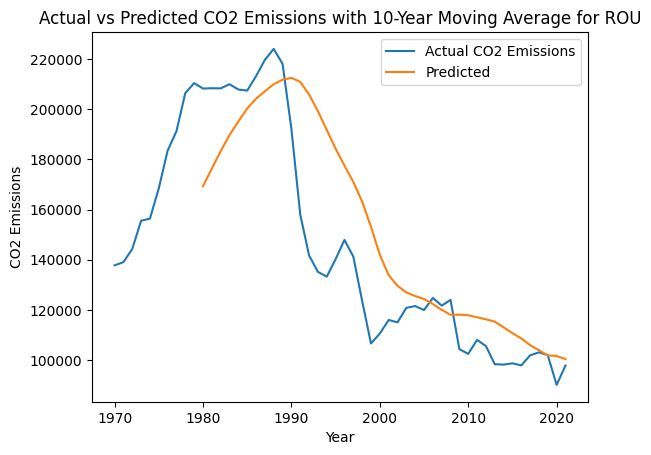

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

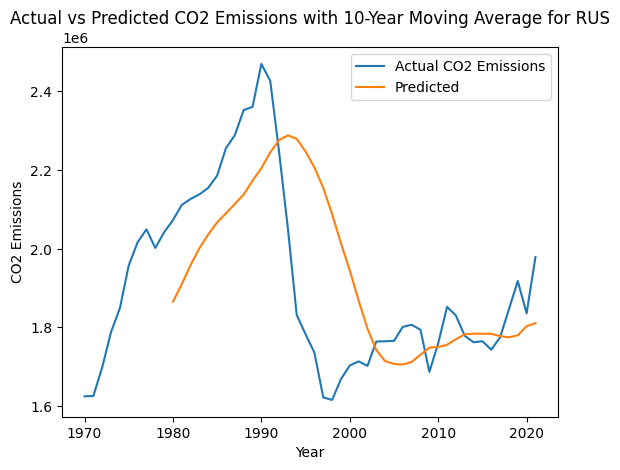

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

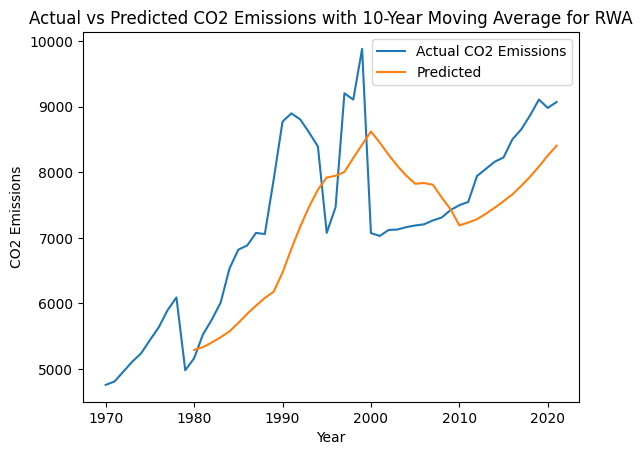

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

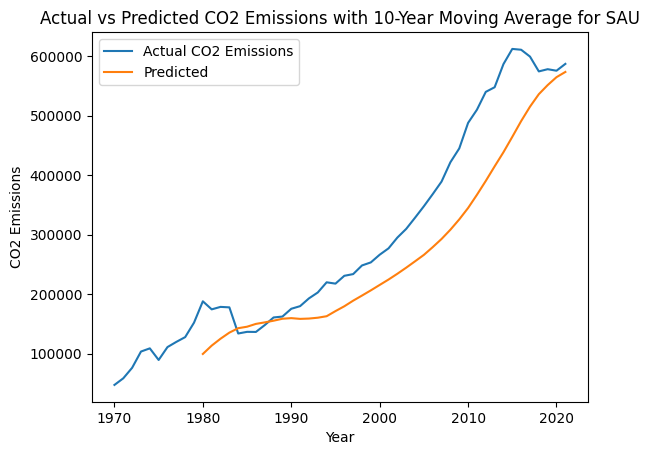

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

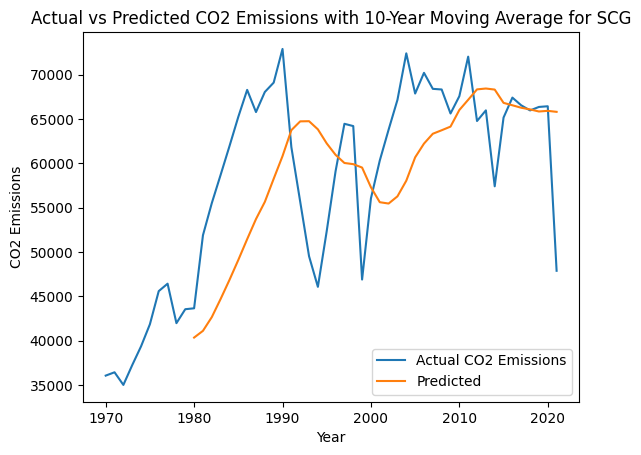

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

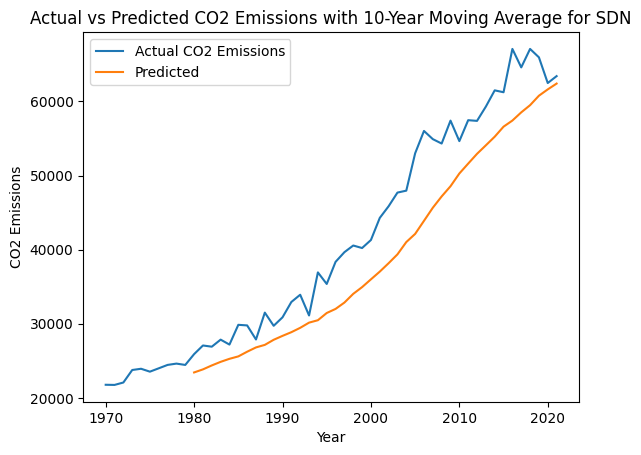

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

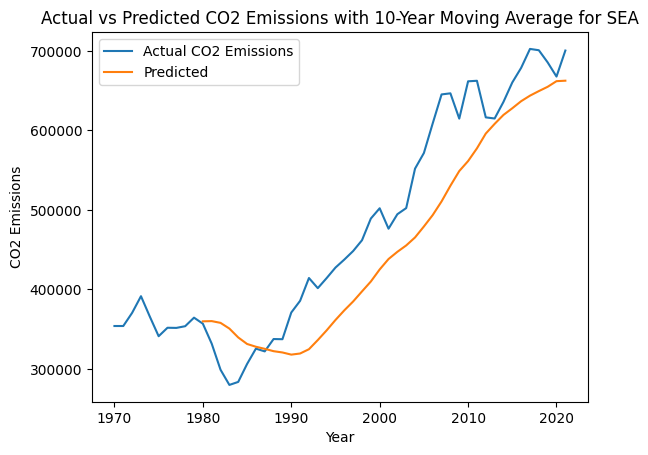

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

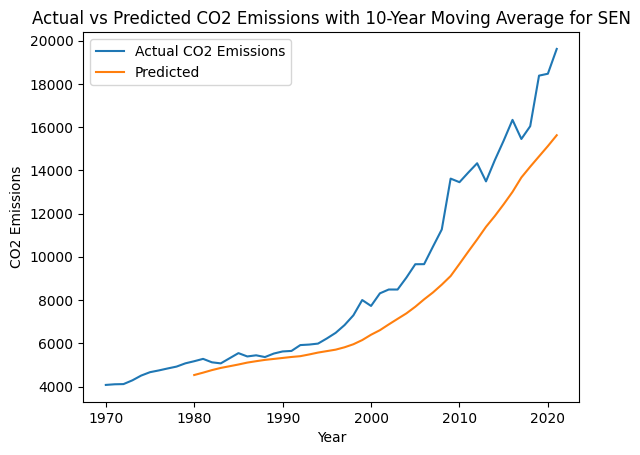

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

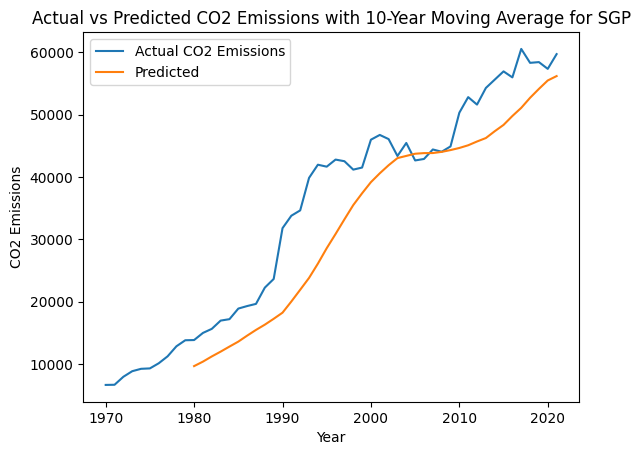

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

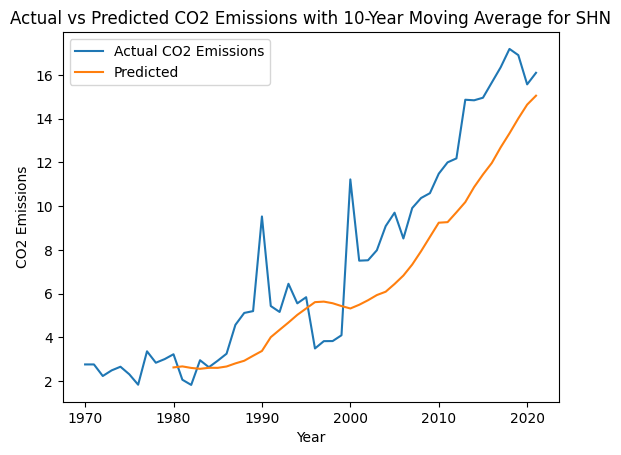

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

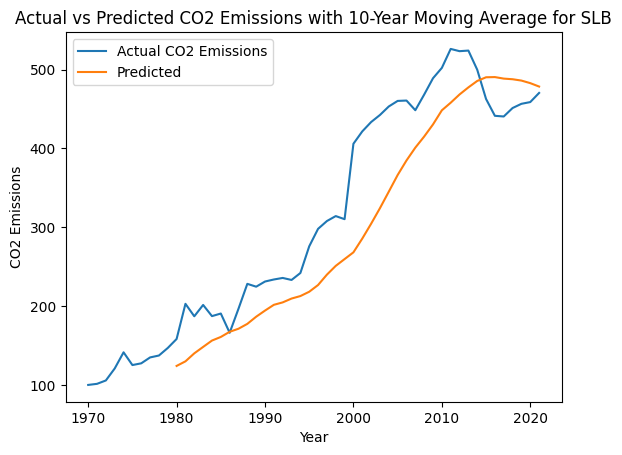

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

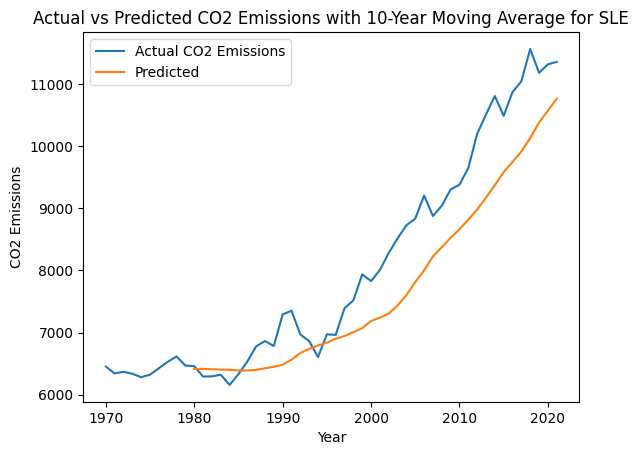

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

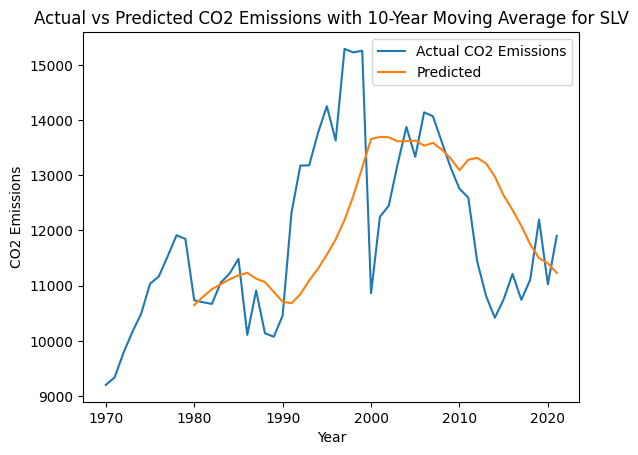

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

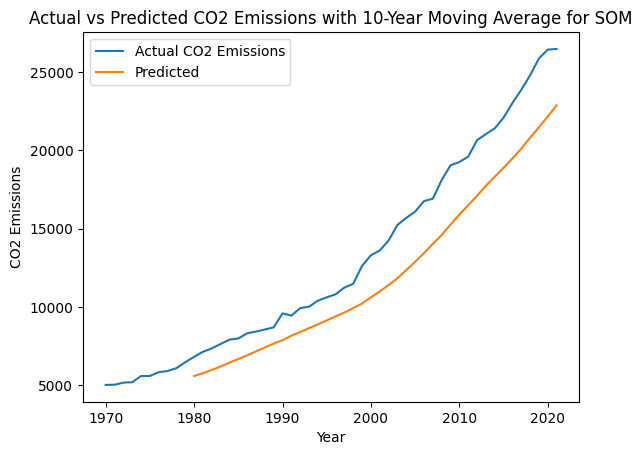

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

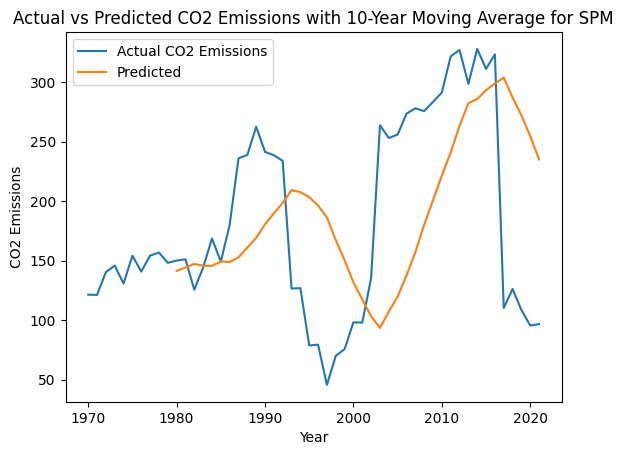

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

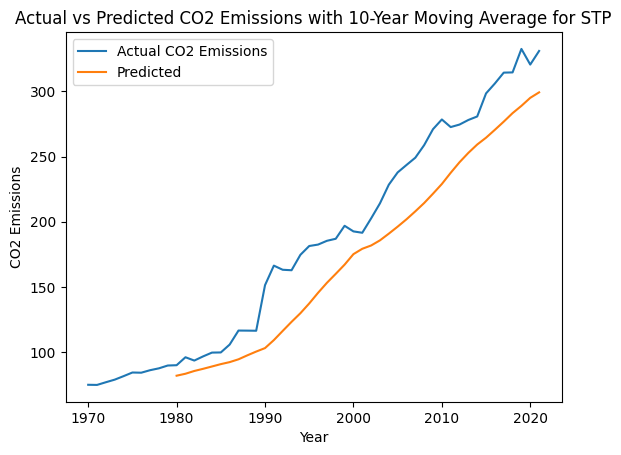

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

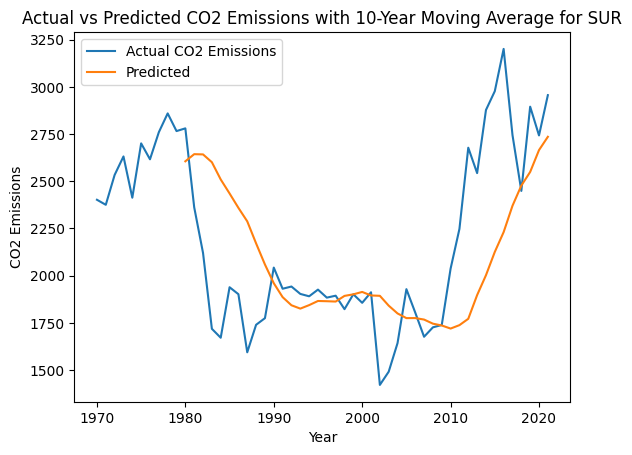

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

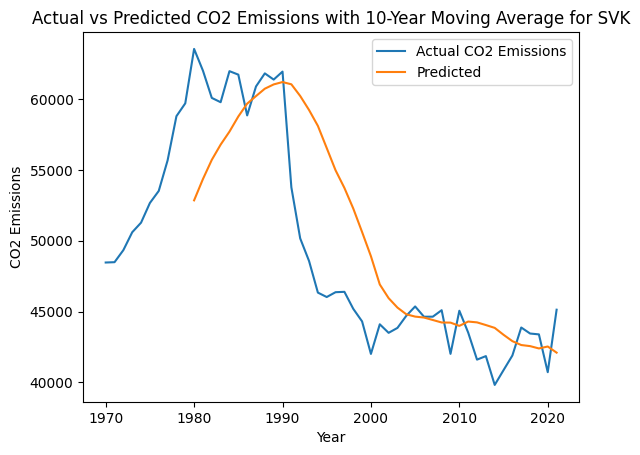

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

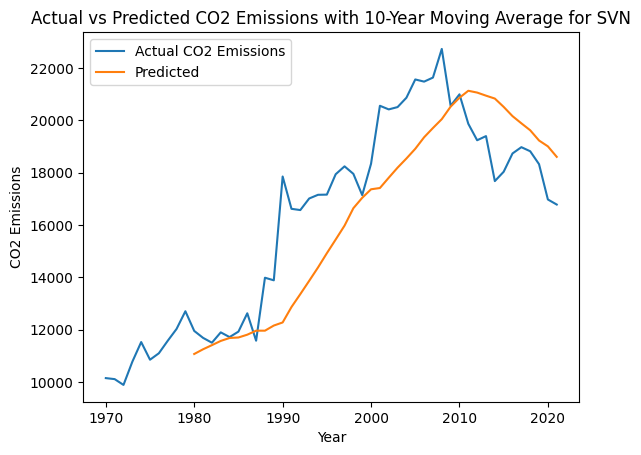

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

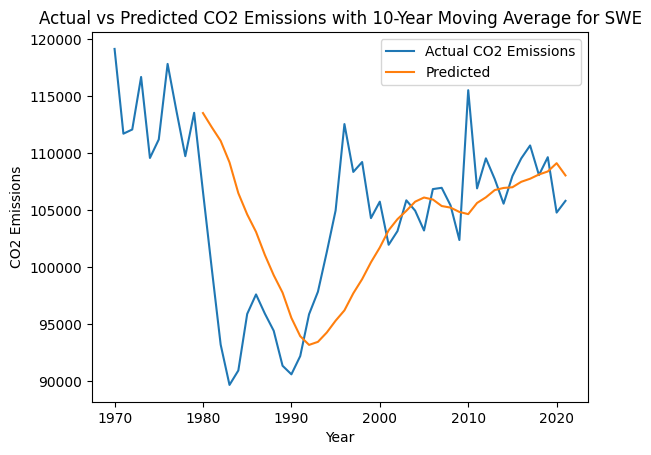

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

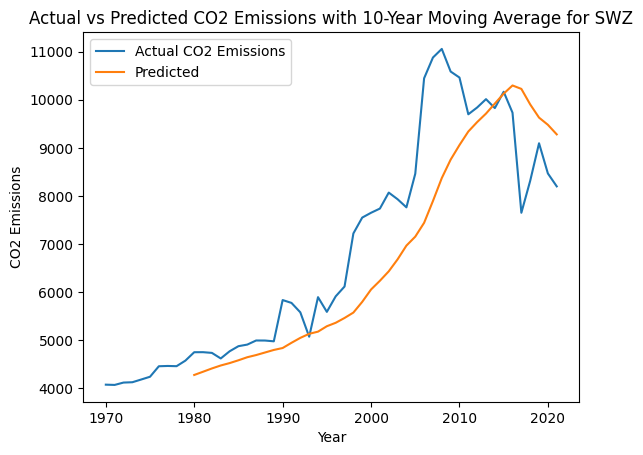

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

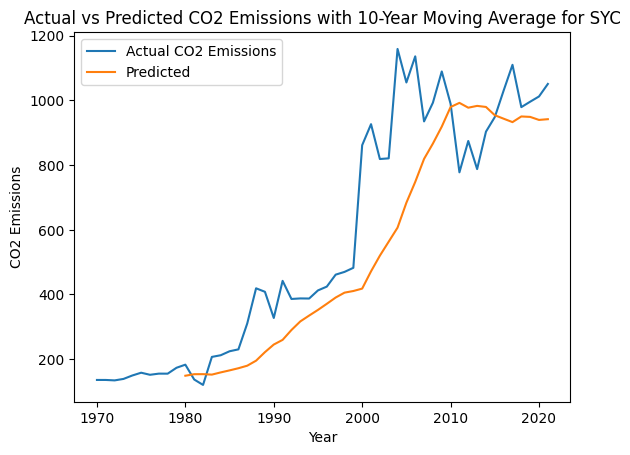

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

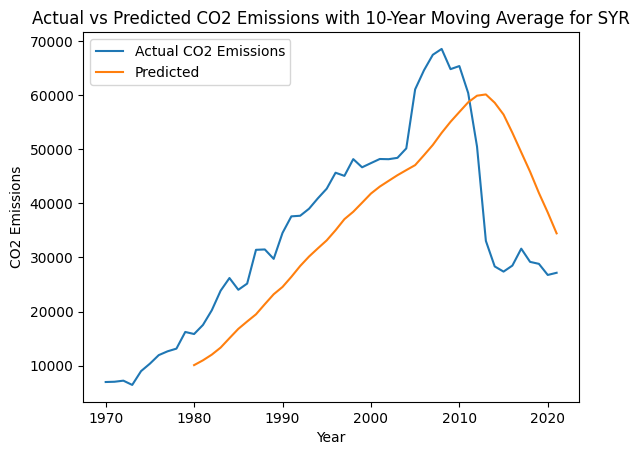

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

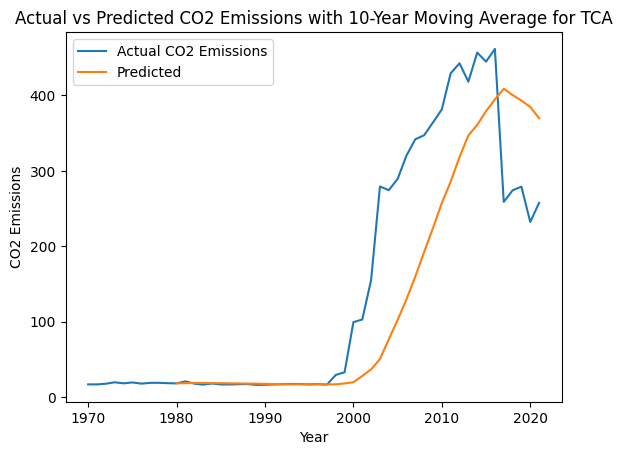

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

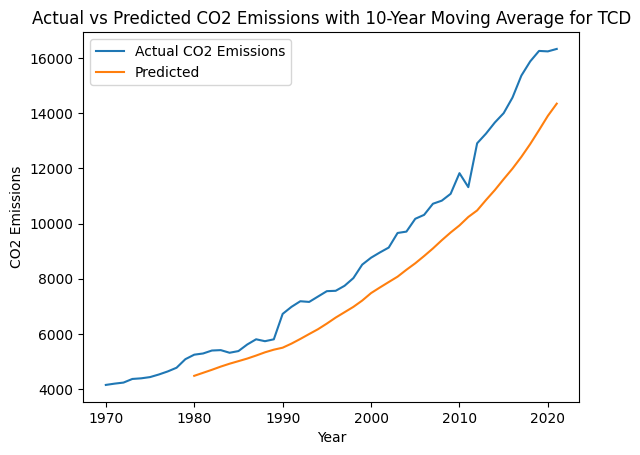

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

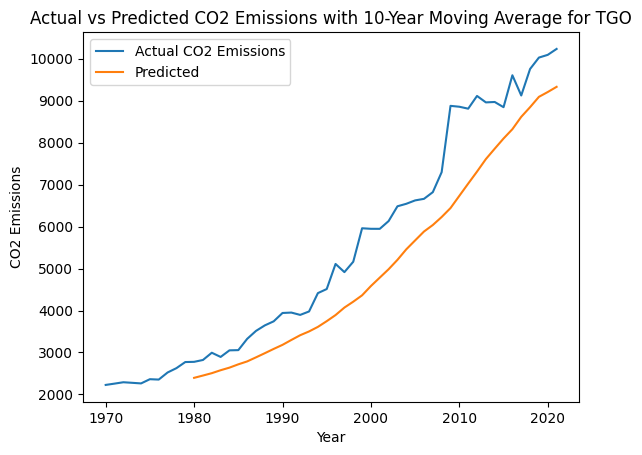

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

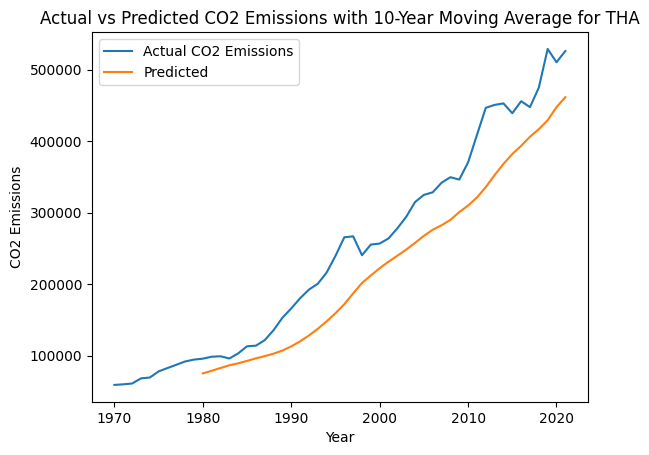

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

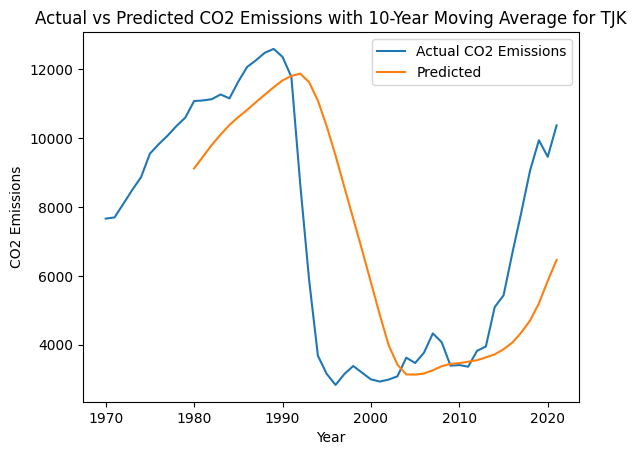

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

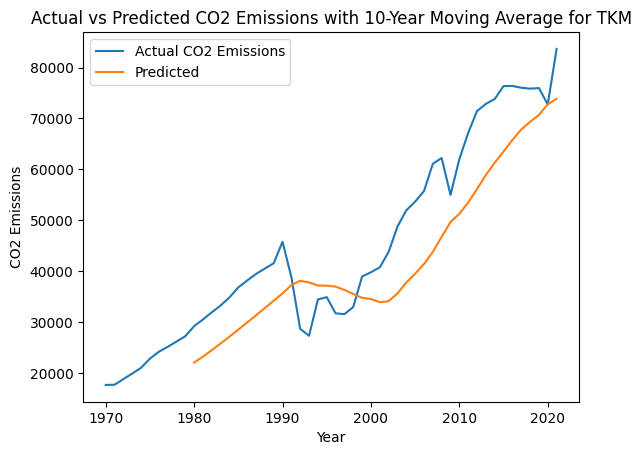

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

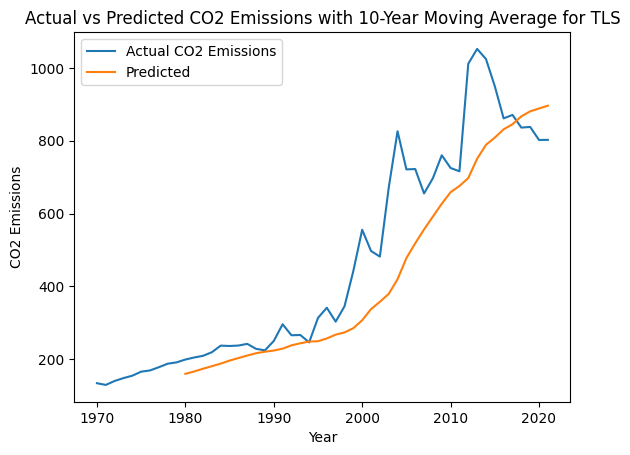

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

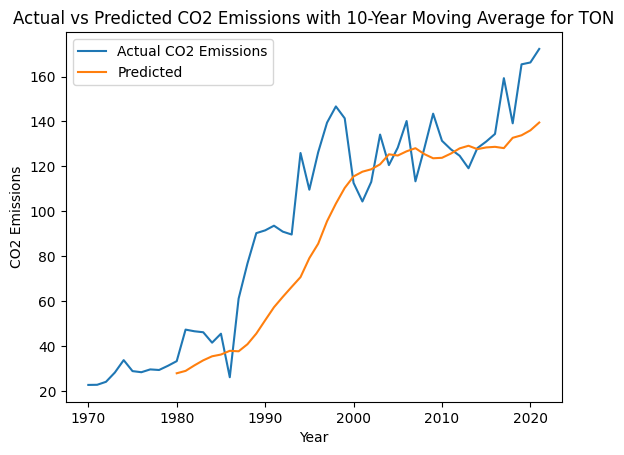

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

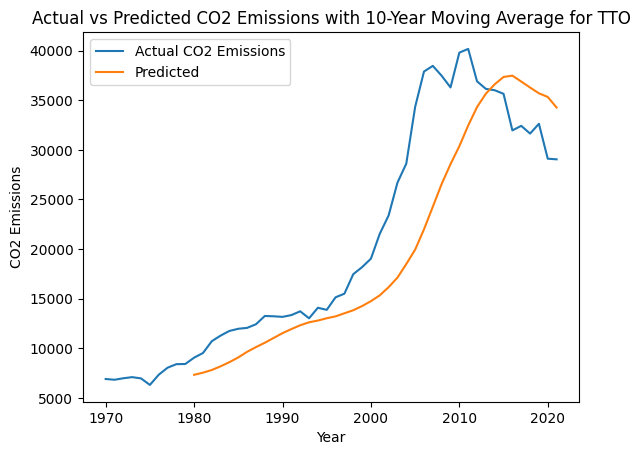

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

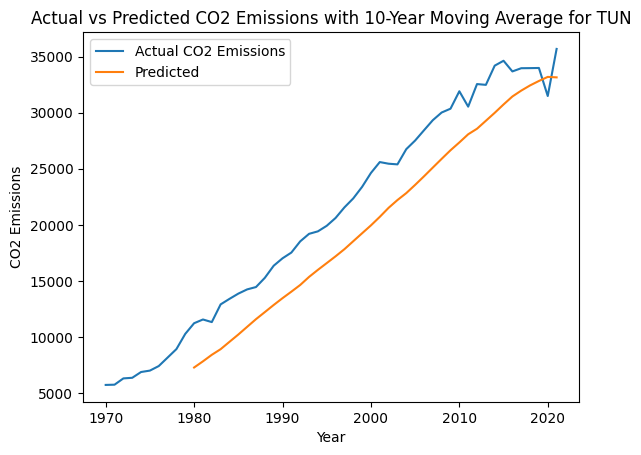

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

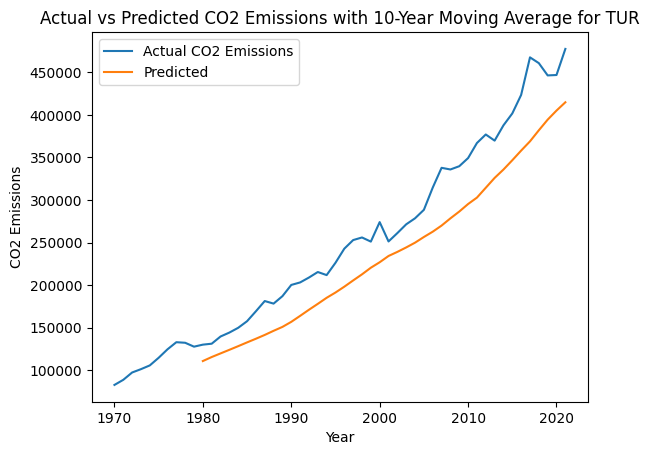

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

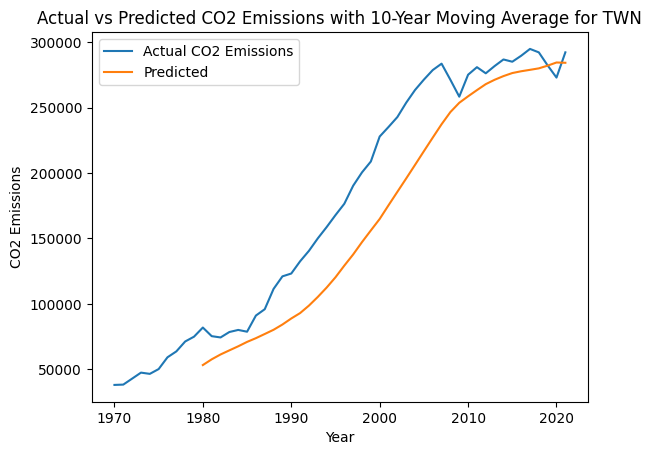

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

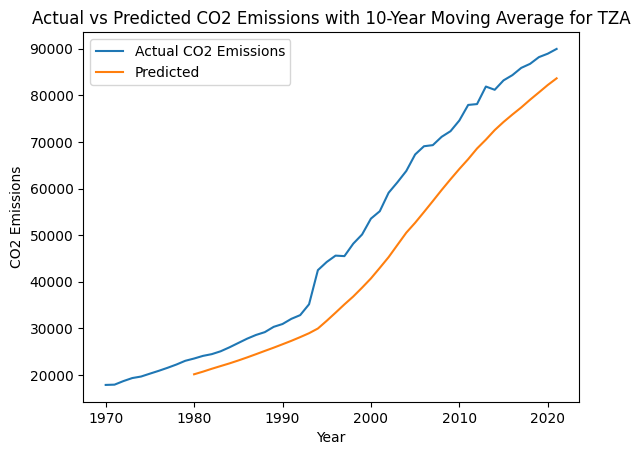

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

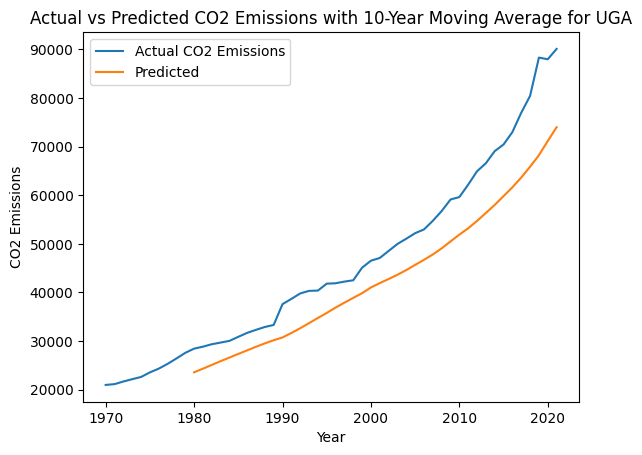

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

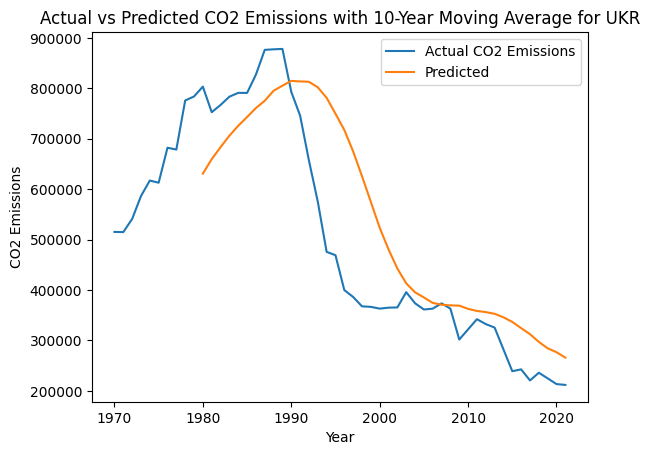

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

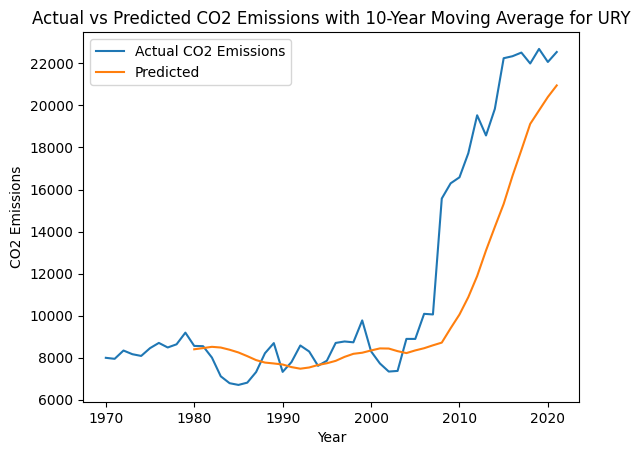

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

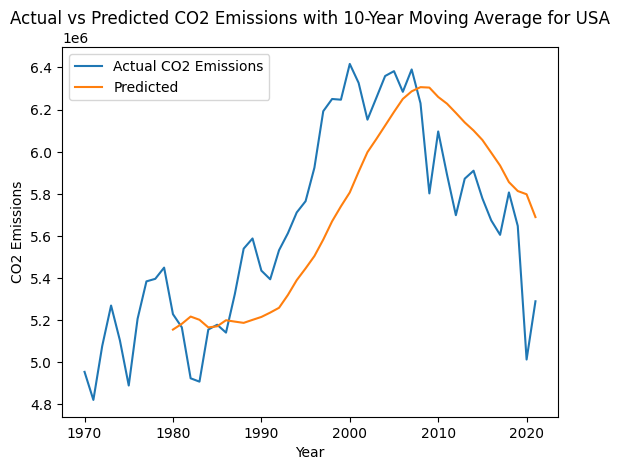

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

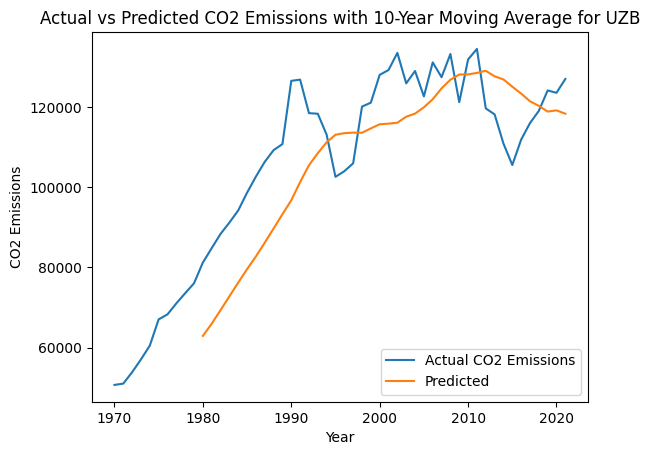

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

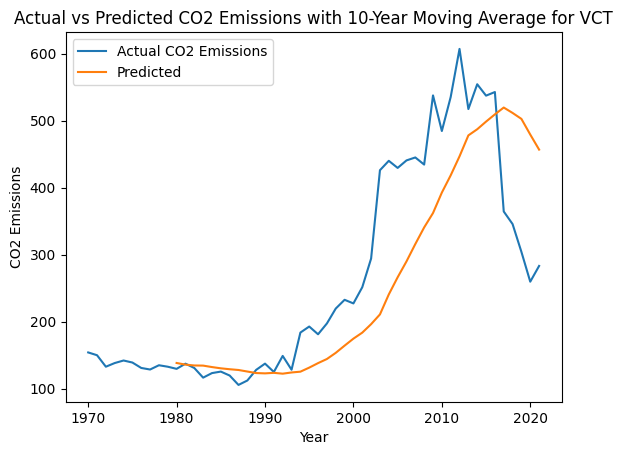

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

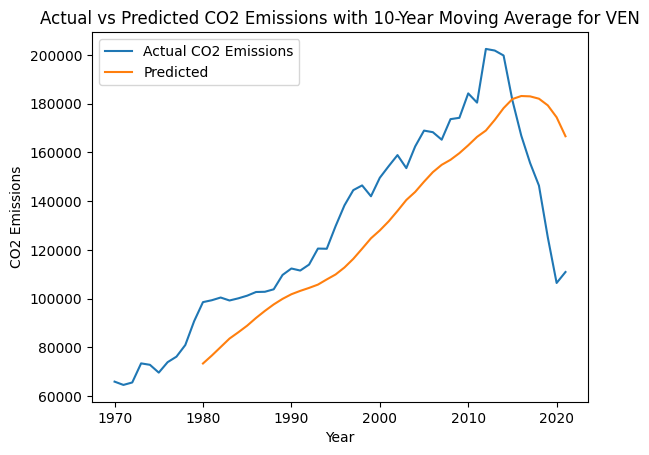

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

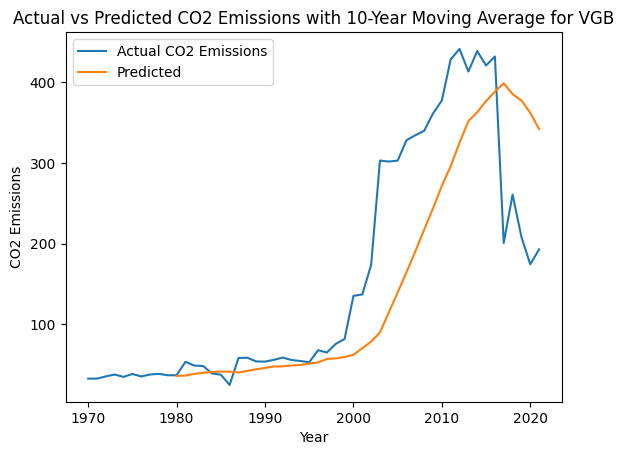

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

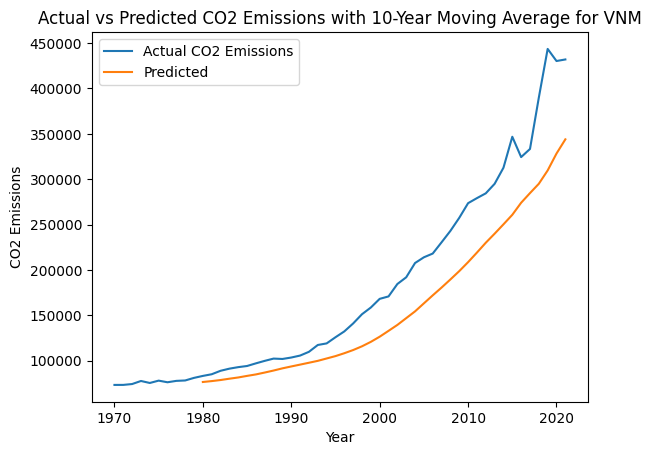

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

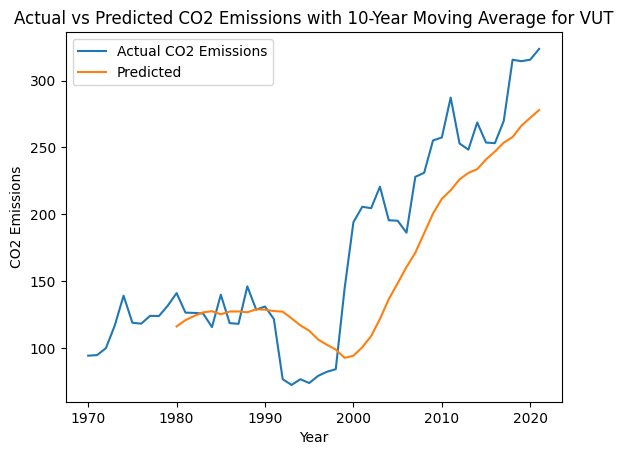

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

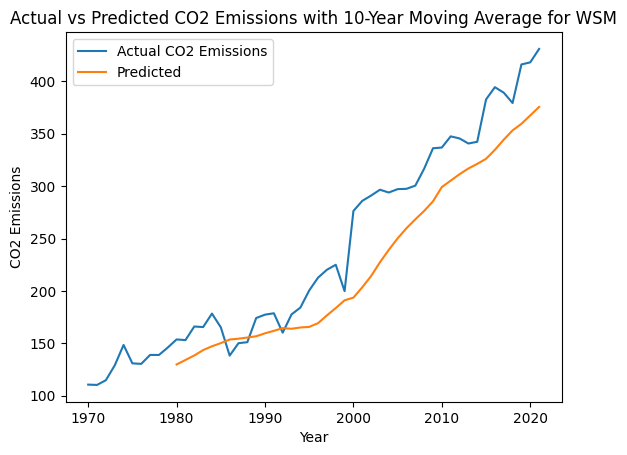

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

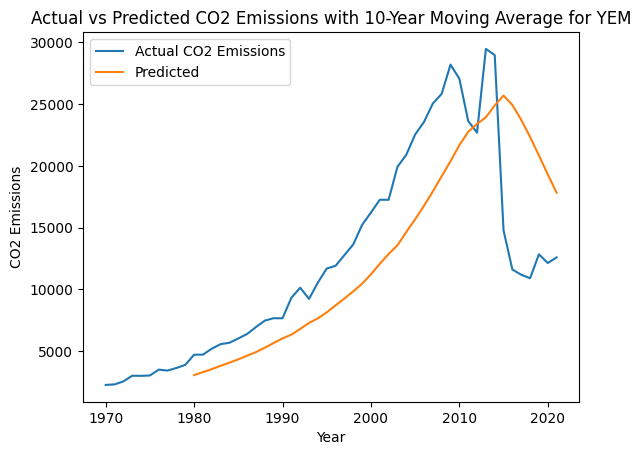

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

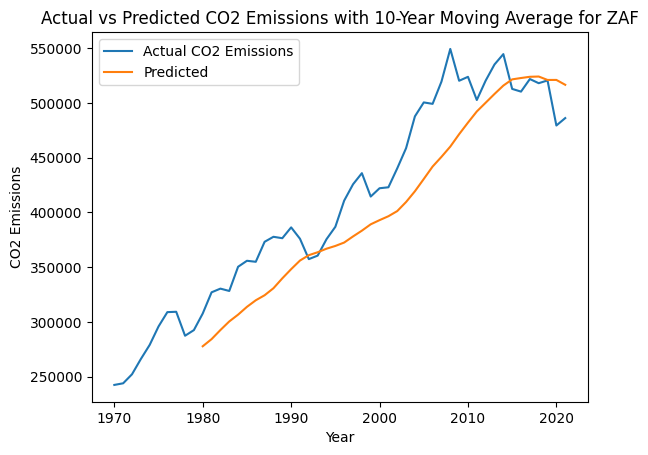

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

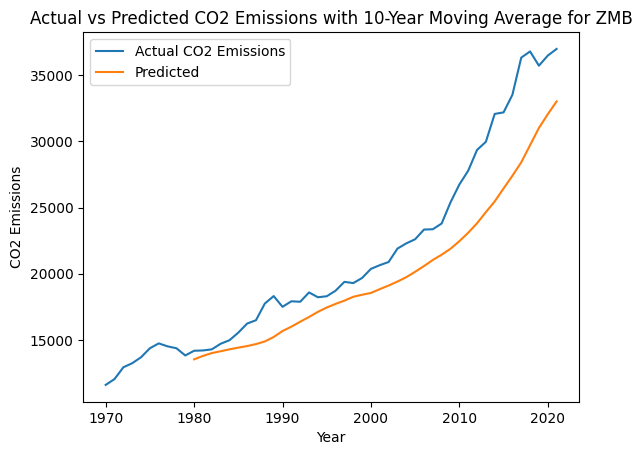

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/6p/h1hkd8xs04qfj29z1r0bdslm0000gn/T/ipykernel_98230/924003081.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

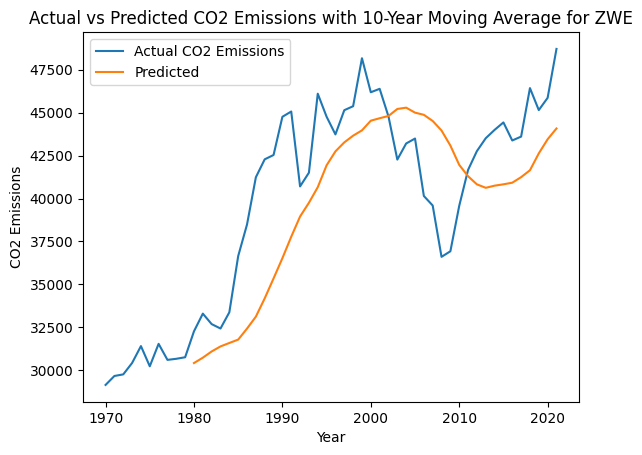

In [78]:
mape_df = pd.DataFrame(columns=['Country', 'MAPE'])
#moving average basemodel 10years pandas 
for country in countries:
    baseline_df = co2_year_df[co2_year_df['country'] == country]

    baseline_df['year'] = pd.to_datetime(baseline_df['year'], format='%Y')
    baseline_df.set_index('year', inplace=True)

    # 10-year moving average into new column
    baseline_df['MA_10'] = baseline_df['CO2'].rolling(10).mean()

    # last value of the moving average as the prediction for each year
    baseline_df['MA_pred'] = baseline_df['MA_10'].shift(1)

    #calculating the APE and MAPE

    baseline_df['APE'] = abs((baseline_df['CO2'] - baseline_df['MA_pred']) / baseline_df['CO2'])
    MAPE = baseline_df['APE'].mean()
    mape_df = mape_df.append({'Country': country, 'MAPE': MAPE}, ignore_index=True)


    # plot actual versus prediction for each year
    plt.plot(baseline_df.index, baseline_df['CO2'], label='Actual CO2 Emissions')
    plt.plot(baseline_df.index, baseline_df['MA_pred'], label='Predicted')
    plt.xlabel('Year')
    plt.ylabel('CO2 Emissions')
    plt.title('Actual vs Predicted CO2 Emissions with 10-Year Moving Average for ' + country)
    plt.legend()
    plt.show()


In [79]:
mape_df

,Country,MAPE
0,ABW,0.234437
1,AFG,0.184567
2,AGO,0.096842
3,AIA,0.262240
4,AIR,0.148568
...,...,...
205,WSM,0.133159
206,YEM,0.355048
207,ZAF,0.078714
208,ZMB,0.110272


## Trend Analysis


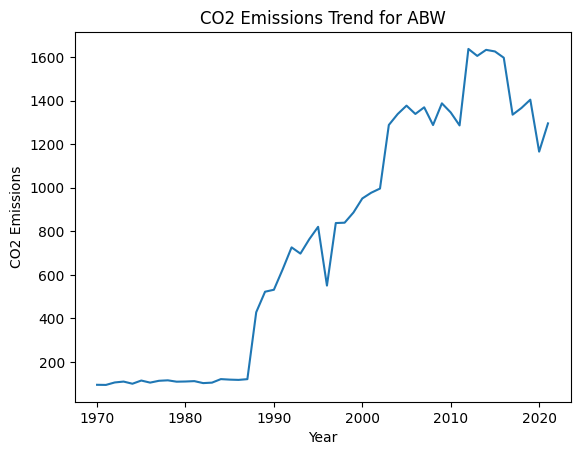

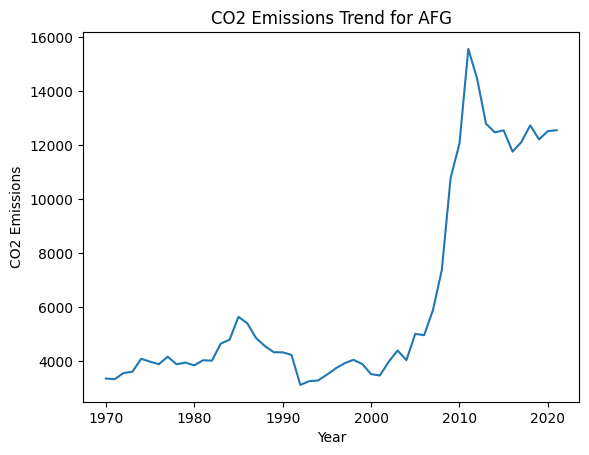

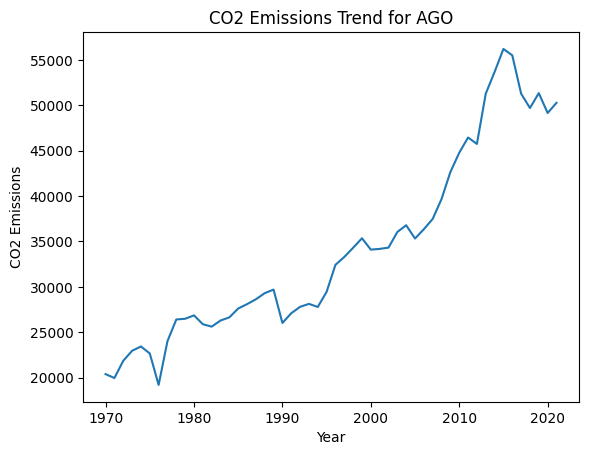

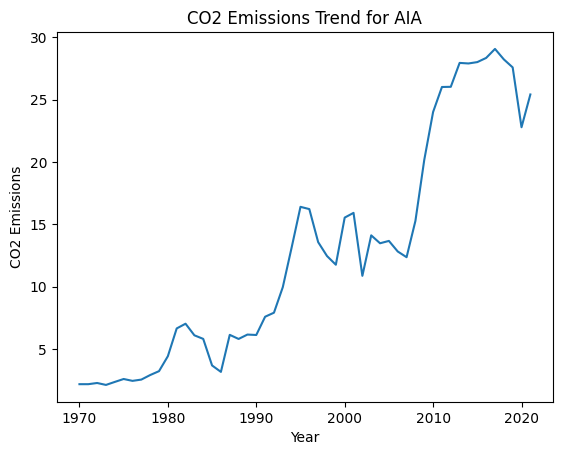

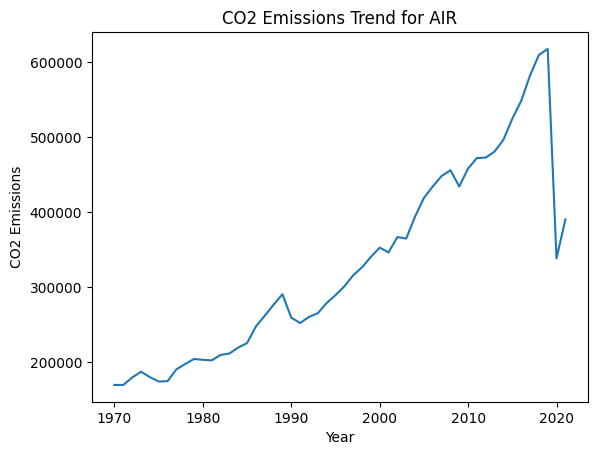

...

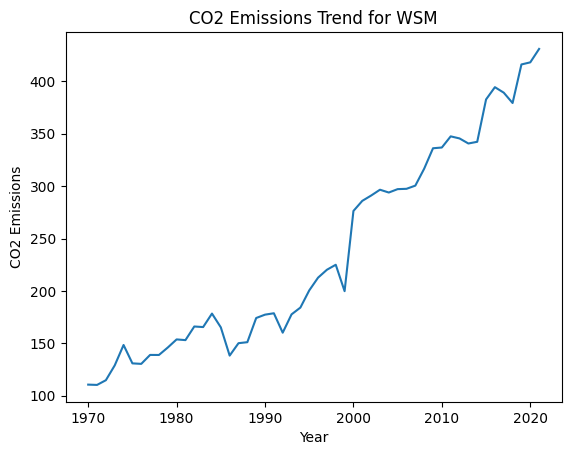

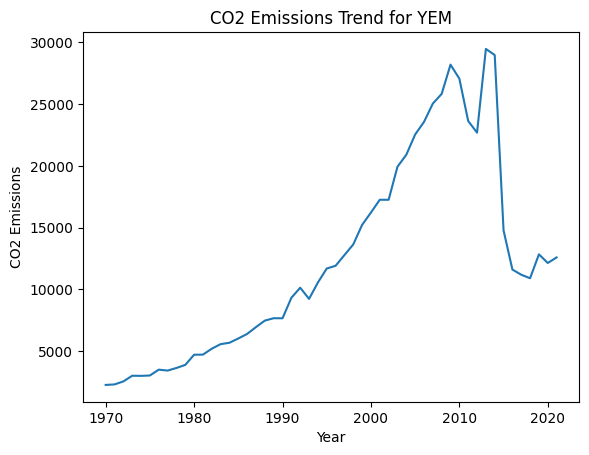

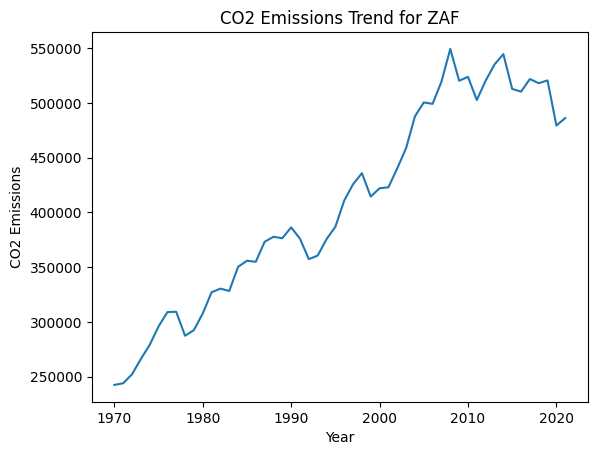

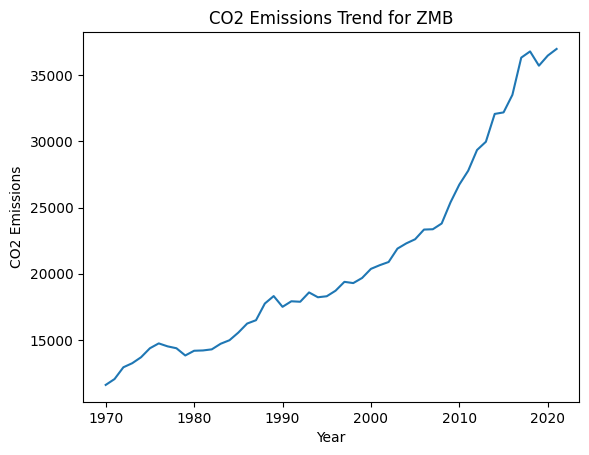

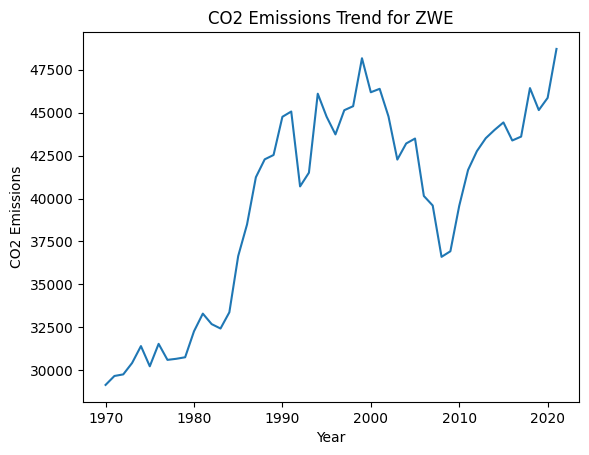

In [59]:
countries= co2_year_df['country'].unique()

for country in countries:
    baseline_df = co2_year_df[co2_year_df['country'] == country]

    
    plt.plot(new_df['year'], new_df['CO2'])
    plt.xlabel('Year')
    plt.ylabel('CO2 Emissions')
    plt.title('CO2 Emissions Trend for ' + country)
    plt.show()

In [99]:
from statsmodels.tsa.seasonal import seasonal_decompose


In [106]:
# Additive Decomposition (y = Trend + Seasonal + Residuals)
def seasonal_decomposition(df, country, method):
    # filter data for the specific country
    country_df = co2_year_df[co2_year_df['country'] == country].copy()

    # set the index to the year column and convert to datetime
    country_df.set_index('year', inplace=True)
    country_df.index = pd.to_datetime(country_df.index, format='%Y')

    # perform seasonal decomposition
    result = seasonal_decompose(country_df['CO2'], model=method)

    # plot the decomposition
    result.plot()
    plt.suptitle('Seasonal Decomposition for ' + country, fontsize=14)
    plt.show()

    return result


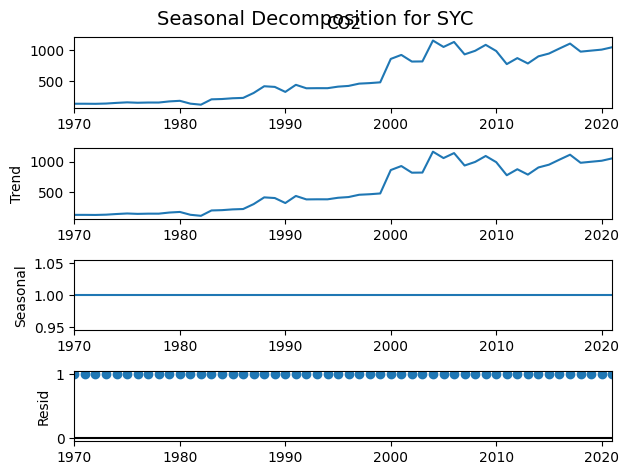

In [107]:
seasonal_decomposition(co2_year_df,np.random.choice(countries),method='multiplicative')